# COCO Dataset

In [1]:
import sys
sys.path.append('../../')

%load_ext autoreload
%autoreload 2

from dl.data.txtdetn import augmentations
from dl.data.txtdetn import datasets, target_transforms, transforms

In [2]:
augmentation = None

transform = transforms.Compose(
    [transforms.ToTensor(),
     #transforms.Normalize(rgb_means=(0.485, 0.456, 0.406), rgb_stds=(0.229, 0.224, 0.225))]
    ]
)
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.COCO2014Text_Dataset(ignore=target_transforms.Ignore(illegible=False), transform=transform, target_transform=target_transform, augmentation=None)


loading annotations into memory...
0:00:00.972730
creating index...
index created!


In [3]:
from dl.data.utils.boxes import centroids2corners
#from ssd.core.inference import toVisualizeRectangleRGBimg
from dl.data.utils.converter import toVisualizeQuadsRGBimg, toVisualizeRectRGBimg

%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import cv2, torch

# yellow rectangle is minimum bbox, red one is quadrilateral bbox

['06/17/2013']


<IPython.core.display.Javascript object>


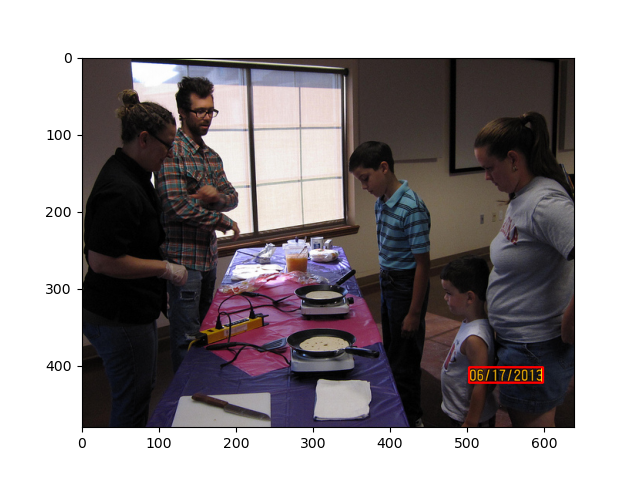

['', 'VIC', '', 'ROSE', 'sunglasshut', 'GEOX', '', '', '']


<IPython.core.display.Javascript object>


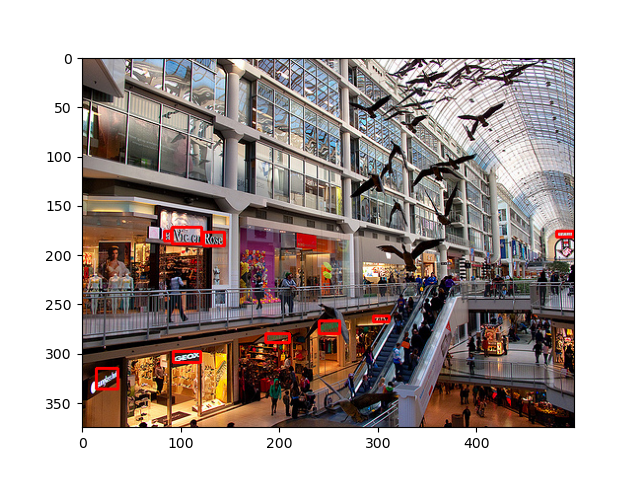

['JOYISH', 'FOWRDSDOD']


<IPython.core.display.Javascript object>


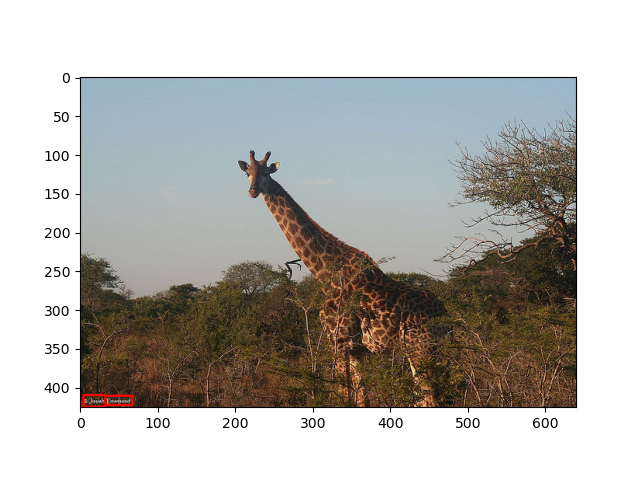

['SWEDISH', 'R', 'Instr', 'AWARDS', '2013', 'Swedish', 'allenge', 'pectiv', 'THE', '']


<IPython.core.display.Javascript object>


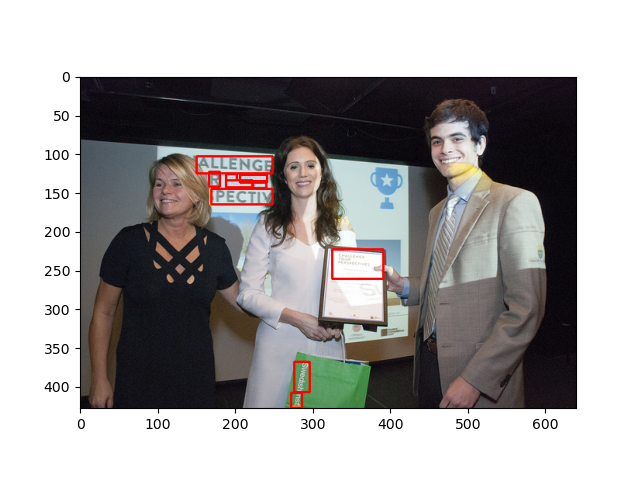

['DEX', '', 'EVERLAST', '', 'citibank']


<IPython.core.display.Javascript object>


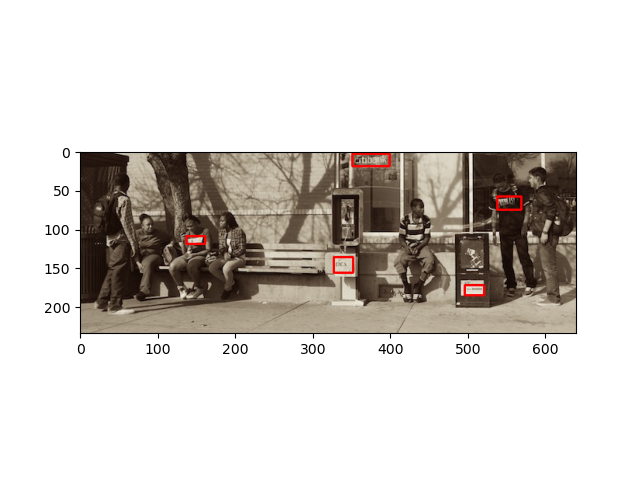

['stop']


<IPython.core.display.Javascript object>


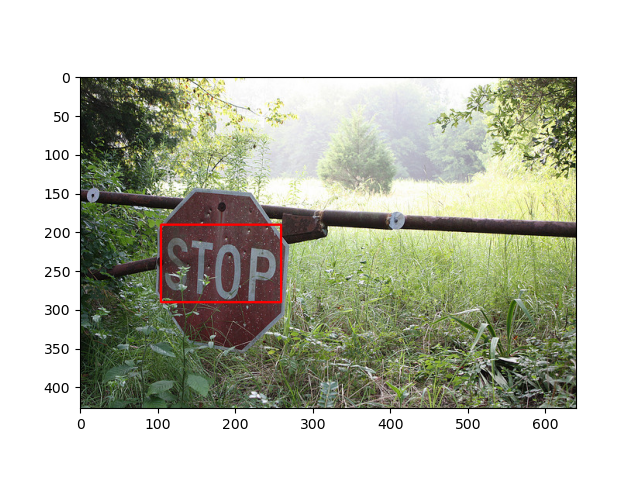

['sour', 'supreme', '', '', '']


<IPython.core.display.Javascript object>


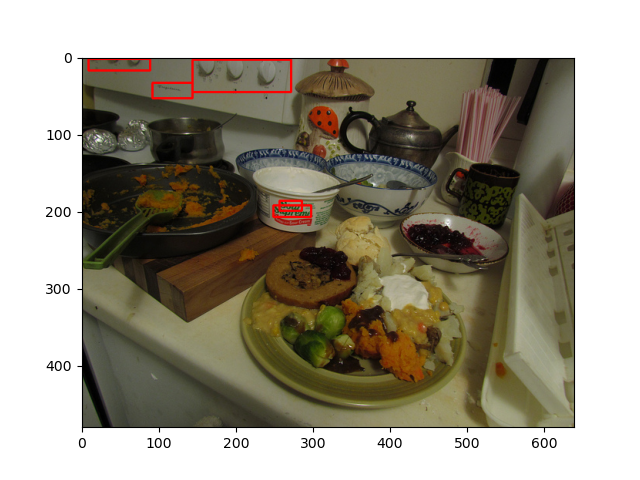

['alexandre', 'Olivo', 'Dell']


<IPython.core.display.Javascript object>


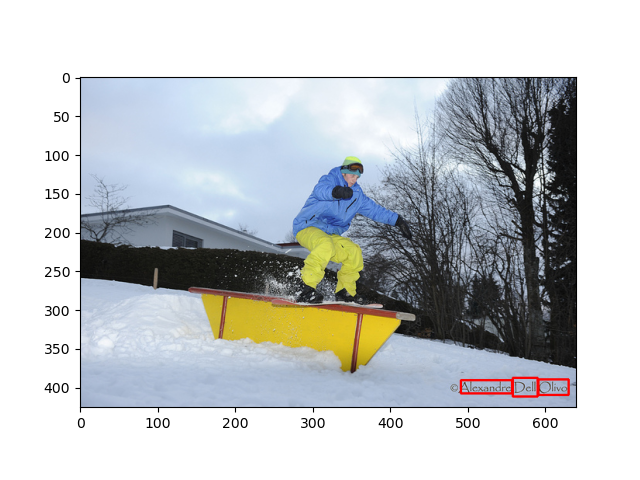

['OILERS']


<IPython.core.display.Javascript object>


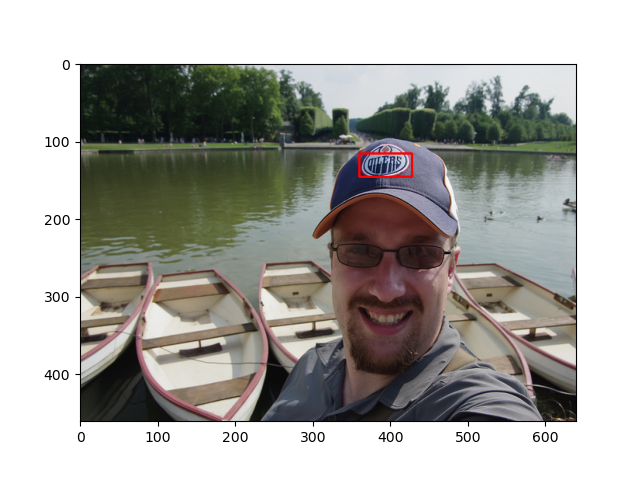

['CONDOR', 'FLIEGEN']


<IPython.core.display.Javascript object>


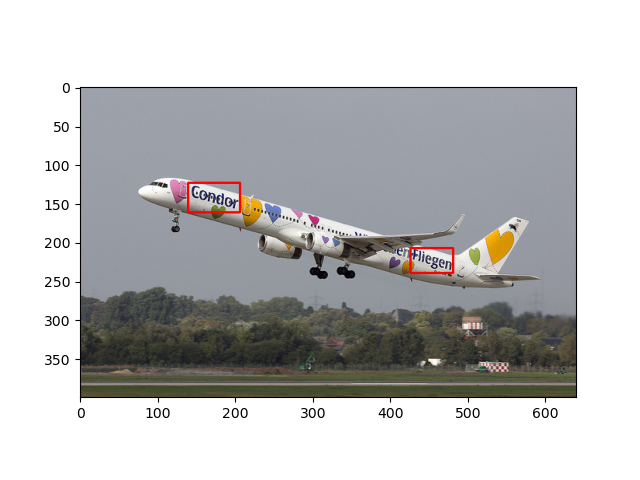

['1', '45', '45', 'CENTRAL']


<IPython.core.display.Javascript object>


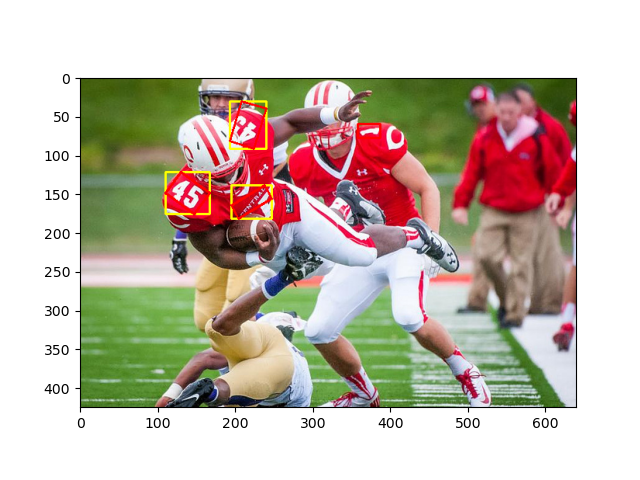

['', '', '', 'A', 'KALAMAZOO', '']


<IPython.core.display.Javascript object>


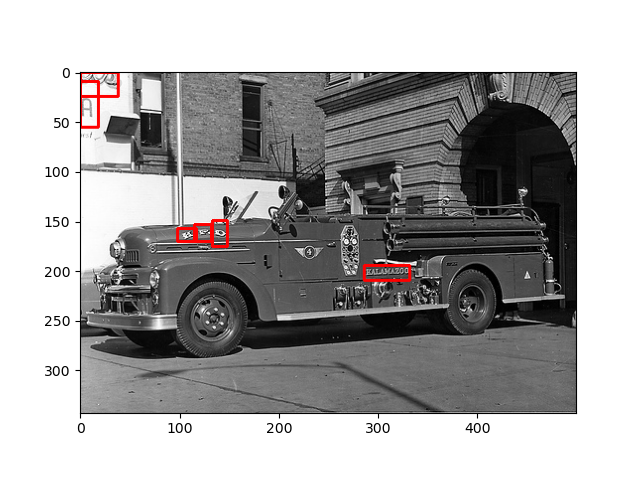

['coke', 'DIET']


<IPython.core.display.Javascript object>


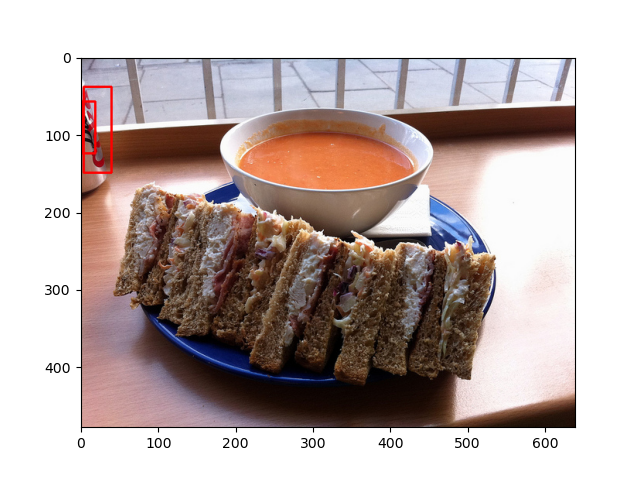

['', '9']


<IPython.core.display.Javascript object>


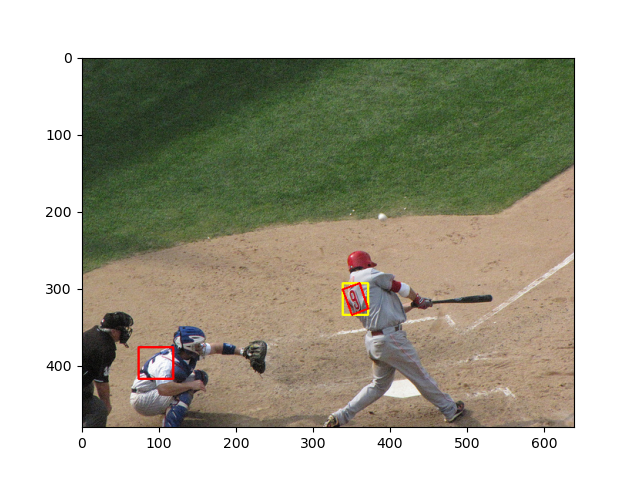

['TEL', '']


<IPython.core.display.Javascript object>


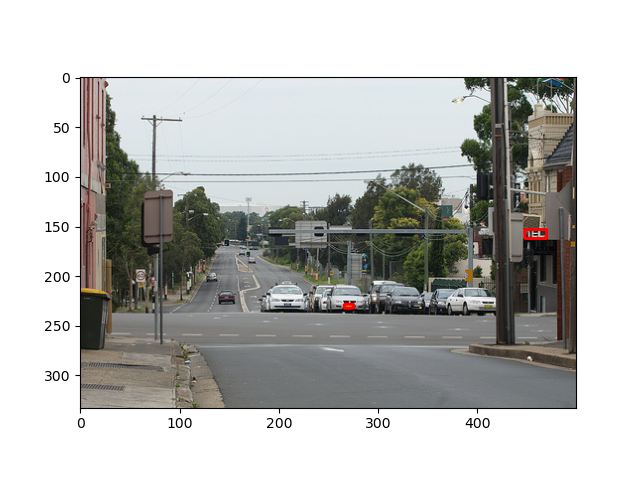

In [4]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# SynthText

In [5]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.SynthTextDetectionDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

["I've", 'the', 'the', 'Could', '197', 'sample', 'this', 'time', 'give', 'and']
tensor([[0.6278, 0.0261, 0.0740, 0.0329],
        [0.6236, 0.0688, 0.0663, 0.0305],
        [0.3431, 0.8074, 0.0926, 0.0442],
        [0.7298, 0.0432, 0.1427, 0.0641],
        [0.2621, 0.8274, 0.0924, 0.0632],
        [0.8487, 0.1116, 0.0948, 0.0223],
        [0.8444, 0.1316, 0.0525, 0.0231],
        [0.8456, 0.1525, 0.0628, 0.0245],
        [0.8432, 0.1748, 0.0661, 0.0252],
        [0.2862, 0.9134, 0.1385, 0.0497]])


<IPython.core.display.Javascript object>


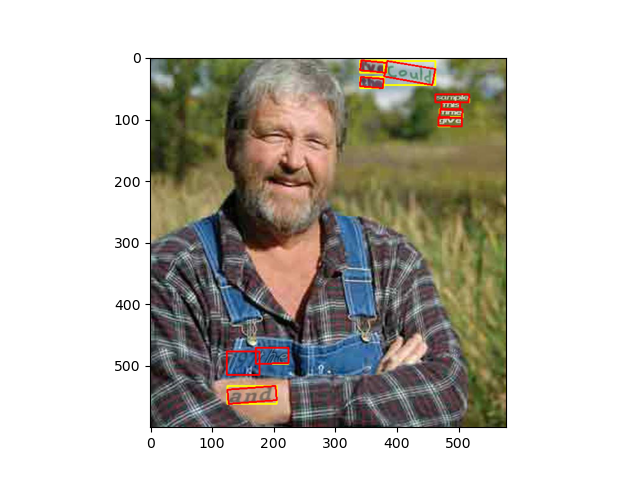

['good', 'Harry', 'N.', 'Beirut,', 'limits']
tensor([[0.0596, 0.8160, 0.1695, 0.1080],
        [0.8999, 0.3778, 0.1136, 0.1177],
        [0.9729, 0.2984, 0.0473, 0.0566],
        [0.8963, 0.4245, 0.1079, 0.1170],
        [0.9365, 0.4090, 0.1343, 0.1493]])


<IPython.core.display.Javascript object>


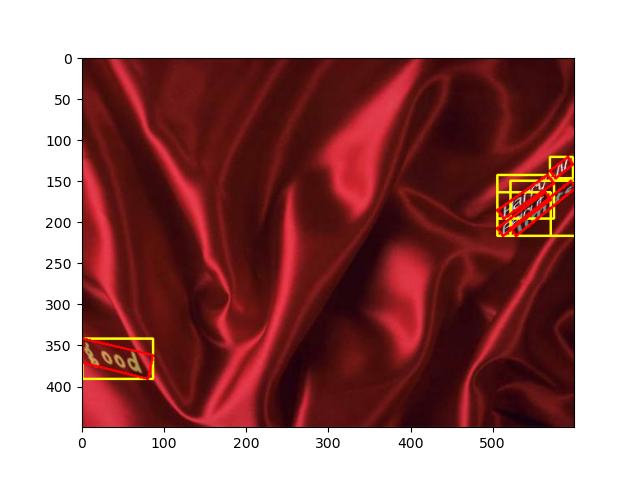

['Sender:', 'Message-ID:', 'To:', 'subscribe', 'From:', 'Newsgroups:', 'RE:', 'need', 'Message-ID:', 'mother"', 'some', 'nations', 'be', 'much', 'they', 'to', 'be', 'facts?']
tensor([[0.7283, 0.4136, 0.1479, 0.0648],
        [0.7429, 0.4721, 0.2419, 0.1074],
        [0.6235, 0.4853, 0.0625, 0.0457],
        [0.6538, 0.5600, 0.1872, 0.1061],
        [0.5825, 0.5874, 0.1093, 0.0776],
        [0.6194, 0.6795, 0.2525, 0.1738],
        [0.4904, 0.6688, 0.0611, 0.0559],
        [0.5743, 0.7293, 0.1027, 0.0857],
        [0.5324, 0.7800, 0.2217, 0.1883],
        [0.2367, 0.1242, 0.4944, 0.2471],
        [0.2154, 0.3057, 0.2880, 0.1444],
        [0.1799, 0.4336, 0.3573, 0.1484],
        [0.0645, 0.5362, 0.1255, 0.0970],
        [0.2869, 0.5726, 0.2256, 0.1010],
        [0.1552, 0.6590, 0.1957, 0.1136],
        [0.7694, 0.3109, 0.0902, 0.0675],
        [0.8945, 0.3307, 0.1203, 0.0767],
        [0.8040, 0.3824, 0.2410, 0.1080]])


<IPython.core.display.Javascript object>


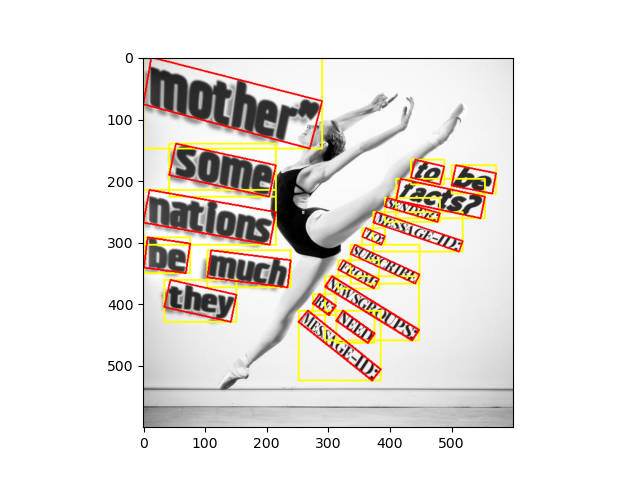

["I'm", 'tell']
tensor([[0.1868, 0.5609, 0.0428, 0.0387],
        [0.2528, 0.2169, 0.2824, 0.3698]])


<IPython.core.display.Javascript object>


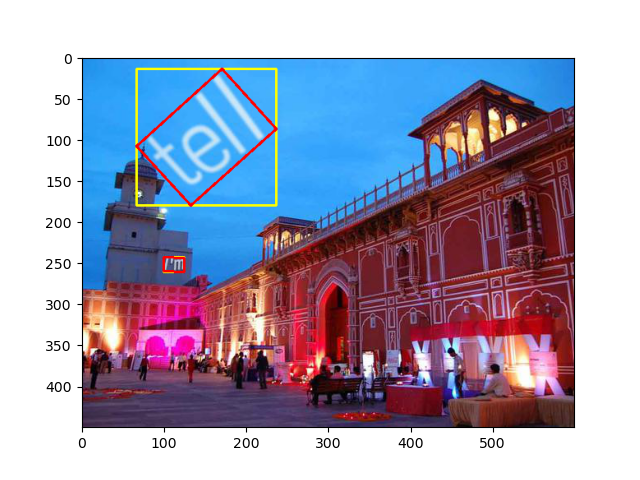

['anybody', 'else', '200,000', '1992', 'Apr']
tensor([[0.1399, 0.9003, 0.1621, 0.0710],
        [0.2753, 0.9146, 0.0700, 0.0456],
        [0.1654, 0.9727, 0.1468, 0.0704],
        [0.9187, 0.5037, 0.0840, 0.1022],
        [0.2349, 0.8158, 0.0872, 0.1037]])


<IPython.core.display.Javascript object>


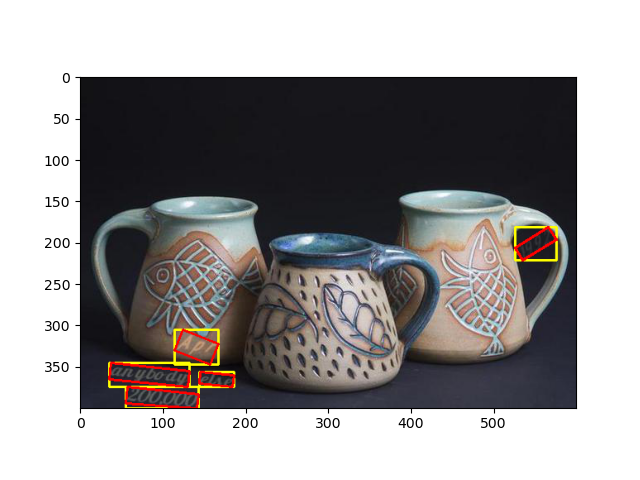

['now', 'Lines:', 'has', 'a', 'flat', '911', 'is']
tensor([[0.1242, 0.8781, 0.0815, 0.0552],
        [0.6701, 0.6124, 0.1146, 0.0365],
        [0.1735, 0.7644, 0.0548, 0.0464],
        [0.4489, 0.6380, 0.0322, 0.0183],
        [0.5445, 0.6276, 0.0984, 0.0282],
        [0.4779, 0.6643, 0.0808, 0.0257],
        [0.5684, 0.6534, 0.0399, 0.0221]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


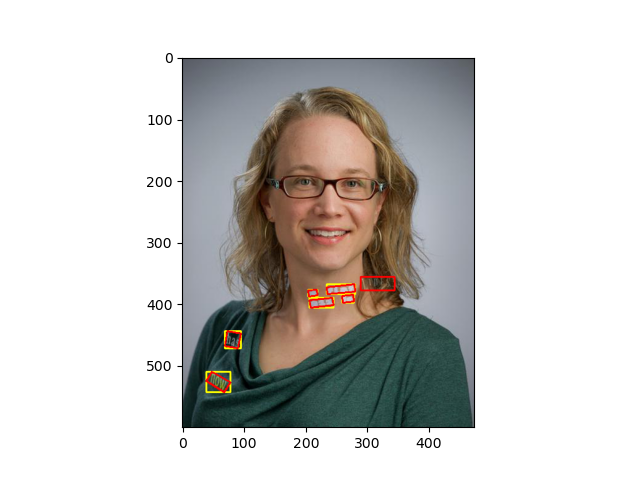

['"at', 'Ben', 'from', 'last', 'we', 'are', 'live', 'TIN', 'the', 'Get', 'freeware', 'Thank', 'you', '.']
tensor([[0.4614, 0.5250, 0.0741, 0.0651],
        [0.0501, 0.4924, 0.0602, 0.0612],
        [0.1554, 0.3591, 0.2306, 0.1496],
        [0.4259, 0.3590, 0.1913, 0.1261],
        [0.3380, 0.9124, 0.1242, 0.0827],
        [0.5210, 0.9026, 0.1157, 0.0811],
        [0.3921, 0.5098, 0.0657, 0.0519],
        [0.2703, 0.5262, 0.0997, 0.0632],
        [0.6399, 0.1682, 0.1401, 0.2884],
        [0.8813, 0.1807, 0.1967, 0.3297],
        [0.7696, 0.4281, 0.4599, 0.2784],
        [0.1334, 0.6287, 0.1774, 0.0873],
        [0.3101, 0.6489, 0.1004, 0.0770],
        [0.4070, 0.6646, 0.0088, 0.0158]])


<IPython.core.display.Javascript object>


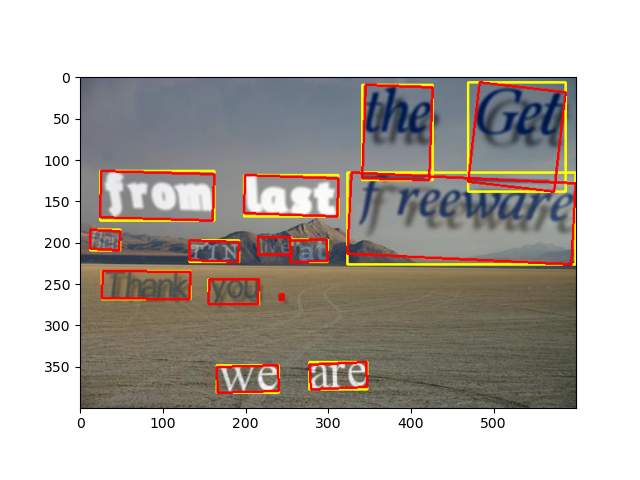

['give', 'not', 'and', 'and', 'The', 'For', 'had']
tensor([[0.2499, 0.7363, 0.1233, 0.1280],
        [0.4702, 0.3207, 0.2257, 0.1957],
        [0.5540, 0.8446, 0.1212, 0.0624],
        [0.7188, 0.7320, 0.0492, 0.0446],
        [0.7246, 0.7846, 0.0489, 0.0452],
        [0.0653, 0.3908, 0.1029, 0.0957],
        [0.4765, 0.4578, 0.1697, 0.1052]])


<IPython.core.display.Javascript object>


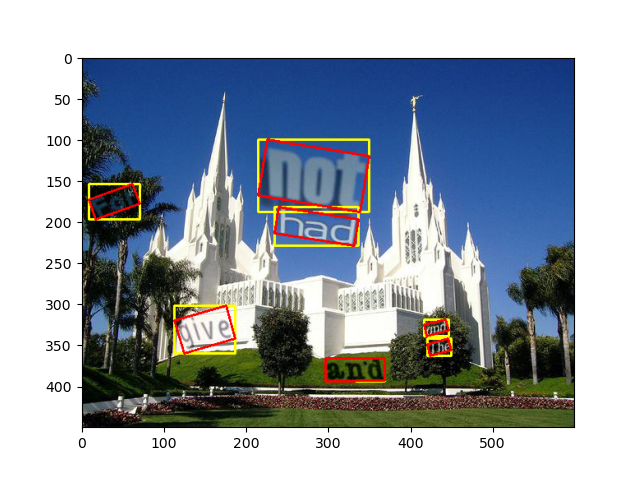

['choose', 'Two', 'but']
tensor([[0.1367, 0.2542, 0.3085, 0.1769],
        [0.1661, 0.4816, 0.1981, 0.0909],
        [0.1243, 0.5506, 0.1694, 0.0782]])


<IPython.core.display.Javascript object>


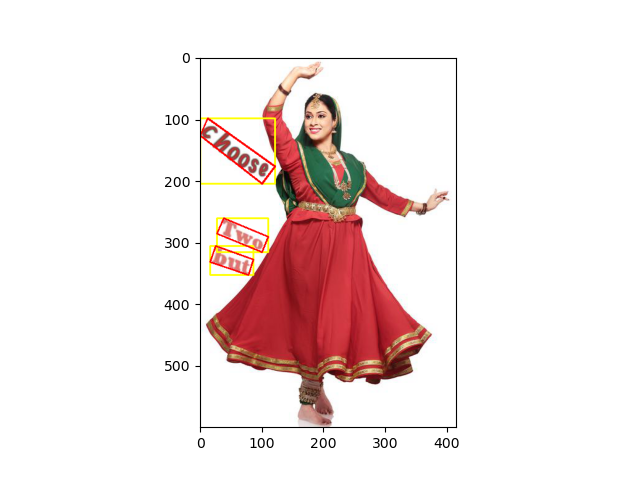

['hurt', 'the', 'Lines:', 'knew', 'it']
tensor([[0.2306, 0.0691, 0.0727, 0.0522],
        [0.3052, 0.0667, 0.0493, 0.0484],
        [0.2438, 0.2300, 0.1204, 0.0724],
        [0.6525, 0.0756, 0.2730, 0.1612],
        [0.8574, 0.0685, 0.0942, 0.1762]])


<IPython.core.display.Javascript object>


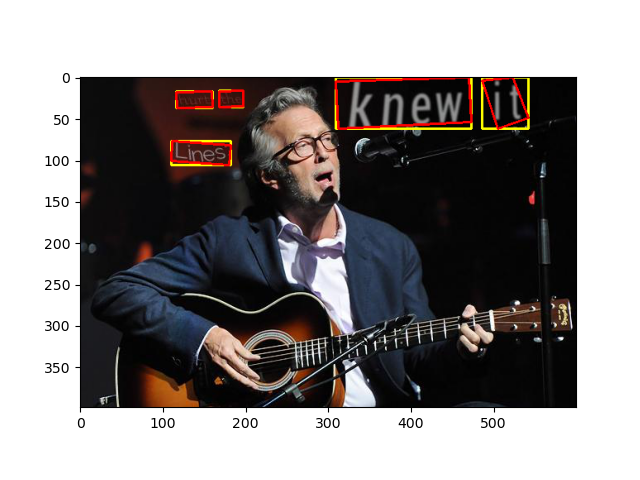

['Rob', '(17', '15,', 'to', 'be', 'works', 'The', 'and']
tensor([[0.3881, 0.8908, 0.1341, 0.0425],
        [0.5750, 0.1646, 0.0726, 0.0578],
        [0.4226, 0.7924, 0.0561, 0.0597],
        [0.4129, 0.3114, 0.0547, 0.0581],
        [0.4967, 0.3713, 0.0638, 0.0655],
        [0.4482, 0.3972, 0.1631, 0.1382],
        [0.4564, 0.9360, 0.1387, 0.0558],
        [0.4092, 0.6890, 0.0954, 0.0965]])


<IPython.core.display.Javascript object>


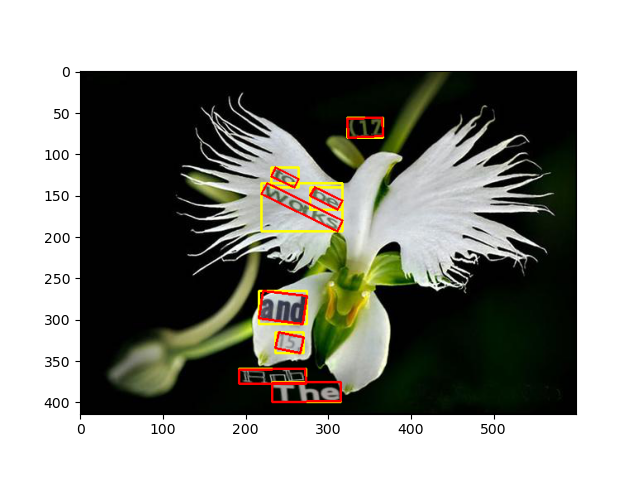

['From:', 'From:', 'that', 'is', 'the', 'Chief', 'Message-ID:']
tensor([[0.3286, 0.7747, 0.3356, 0.1776],
        [0.2969, 0.3732, 0.1986, 0.1205],
        [0.4817, 0.0469, 0.1017, 0.0633],
        [0.5923, 0.0481, 0.0435, 0.0613],
        [0.4069, 0.3569, 0.1032, 0.0887],
        [0.4350, 0.4777, 0.1630, 0.1028],
        [0.2965, 0.0410, 0.2099, 0.0562]])


<IPython.core.display.Javascript object>


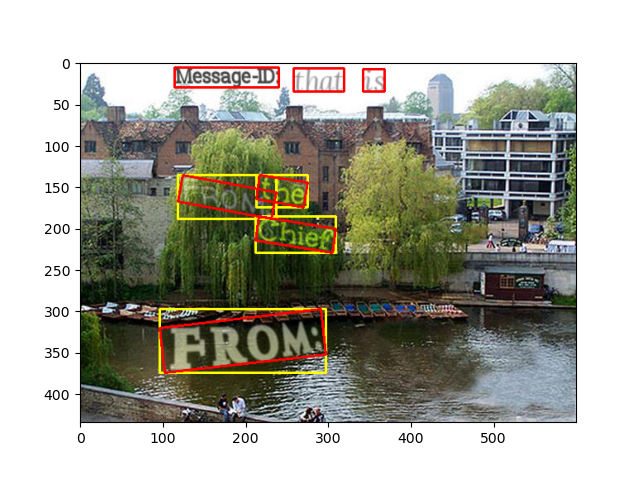

['can', 'B-D', 'the', 'Er,', 'summary', 'to', 'be']
tensor([[0.9006, 0.4400, 0.1102, 0.0303],
        [0.1795, 0.1004, 0.2094, 0.1767],
        [0.8806, 0.5653, 0.0566, 0.0470],
        [0.8760, 0.6390, 0.0529, 0.0570],
        [0.1180, 0.1825, 0.1899, 0.0977],
        [0.0769, 0.2309, 0.0472, 0.0481],
        [0.1445, 0.2493, 0.0503, 0.0514]])


<IPython.core.display.Javascript object>


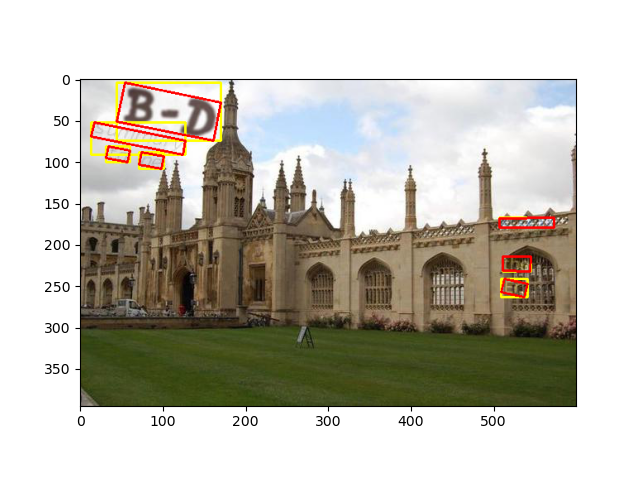

['the', 'Date:', 'Tue,', '27', 'when', 'causes', 'not', 'the', 'video', 'consult']
tensor([[0.7644, 0.1893, 0.1170, 0.0496],
        [0.1895, 0.8199, 0.0802, 0.0837],
        [0.2696, 0.8326, 0.0805, 0.0852],
        [0.3468, 0.8404, 0.0561, 0.0887],
        [0.5000, 0.1167, 0.1307, 0.0449],
        [0.5882, 0.1843, 0.1390, 0.0475],
        [0.4312, 0.9342, 0.1214, 0.0797],
        [0.5016, 0.9393, 0.1124, 0.0715],
        [0.6035, 0.5973, 0.0725, 0.0750],
        [0.5679, 0.1505, 0.1534, 0.0345]])


<IPython.core.display.Javascript object>


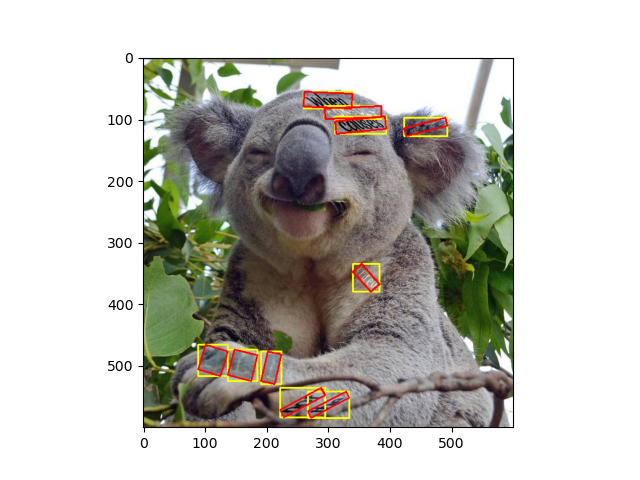

['per', 'BTW,', 'since.', 'hard']
tensor([[0.3118, 0.1987, 0.1245, 0.0996],
        [0.4517, 0.4791, 0.1183, 0.0665],
        [0.1726, 0.9240, 0.2016, 0.0496],
        [0.1940, 0.2535, 0.1060, 0.0811]])


<IPython.core.display.Javascript object>


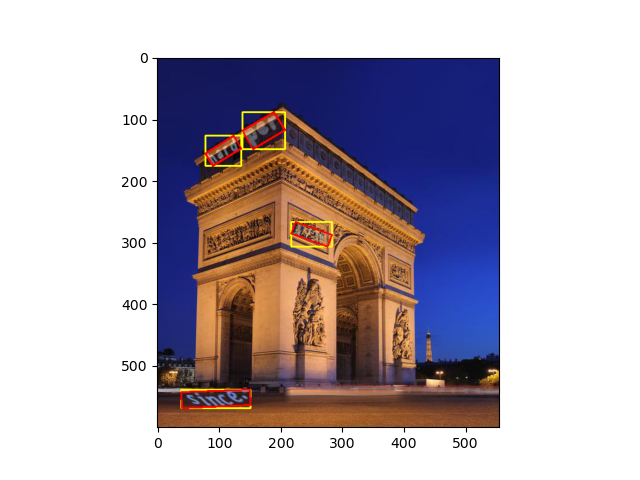

In [6]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# ICDAR2015

In [7]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDAR2015TextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['###', '###', 'GIORDA', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.3758, 0.9465, 0.0641, 0.0458],
        [0.0656, 0.4167, 0.0422, 0.0361],
        [0.7730, 0.1056, 0.4195, 0.2056],
        [0.0273, 0.3104, 0.0203, 0.0292],
        [0.0504, 0.3146, 0.0148, 0.0292],
        [0.1152, 0.3785, 0.0461, 0.0625],
        [0.0895, 0.4917, 0.0148, 0.1444],
        [0.0992, 0.4868, 0.0125, 0.1375],
        [0.1129, 0.4507, 0.0180, 0.0764],
        [0.1113, 0.5312, 0.0180, 0.0681],
        [0.1320, 0.4660, 0.0219, 0.1153]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


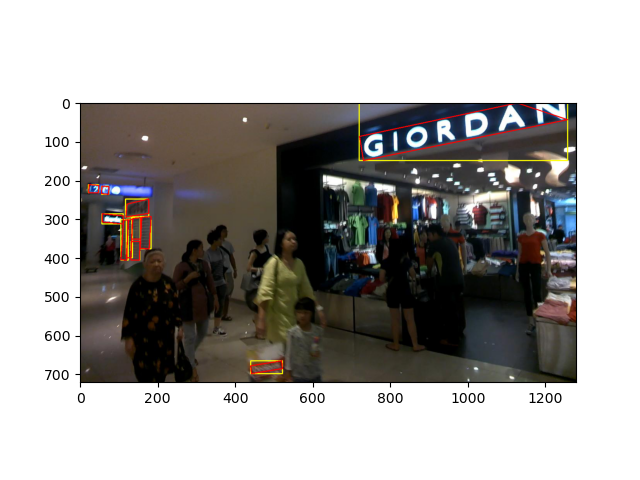

["Men's", '###', 'Hair', '###', '###', 'Care', '###', 'Gorg', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.6594, 0.3229, 0.0938, 0.1181],
        [0.4770, 0.1611, 0.0211, 0.0361],
        [0.8906, 0.0799, 0.0609, 0.0625],
        [0.5832, 0.1278, 0.0273, 0.0472],
        [0.5387, 0.1444, 0.0258, 0.0417],
        [0.7652, 0.3375, 0.1055, 0.1194],
        [0.5055, 0.1542, 0.0219, 0.0389],
        [0.9590, 0.0722, 0.0742, 0.0667],
        [0.2551, 0.0736, 0.0305, 0.0361],
        [0.0902, 0.1618, 0.1023, 0.0597],
        [0.7027, 0.1215, 0.0617, 0.0458],
        [0.6359, 0.1076, 0.0562, 0.0542],
        [0.6367, 0.1389, 0.0562, 0.0389],
        [0.6348, 0.1660, 0.0539, 0.0347],
        [0.5219, 0.5875, 0.0266, 0.0444]])


<IPython.core.display.Javascript object>


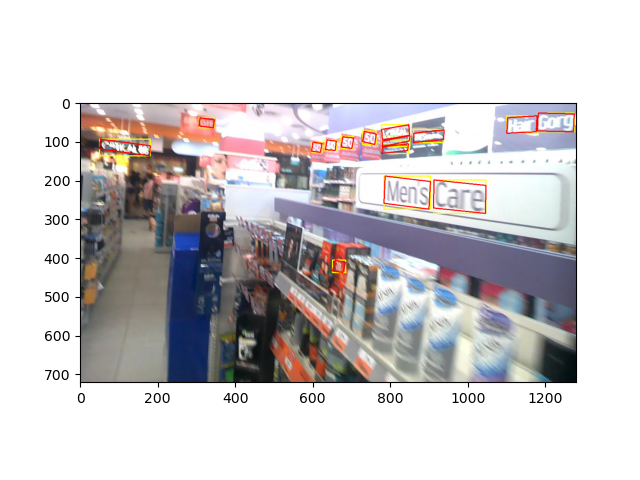

['Flowers', '###', '###', 'Cut', '###']
tensor([[0.4066, 0.0611, 0.1586, 0.0750],
        [0.9684, 0.1132, 0.0602, 0.0653],
        [0.9723, 0.1646, 0.0492, 0.0597],
        [0.4793, 0.0181, 0.0633, 0.0361],
        [0.4020, 0.0167, 0.0727, 0.0278]])


<IPython.core.display.Javascript object>


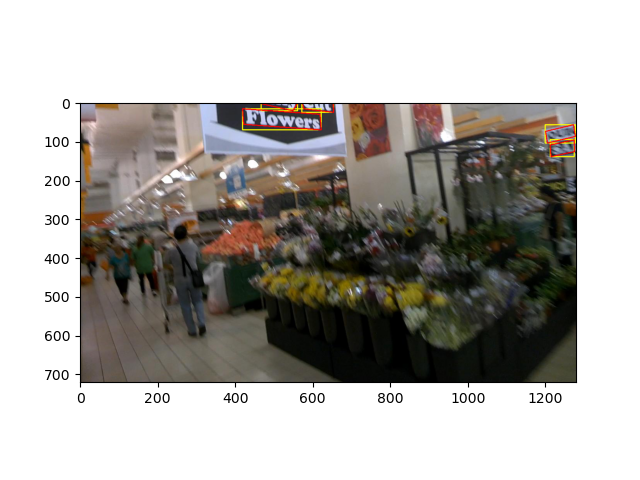

['###', '###', 'EMPLOYMENT', 'AGENCY', '###', 'KONG', 'Licence', 'SING', 'No:', '03C5262', 'MAIDS', '###', '###', '###', '###', 'INDONESIAN', '###', '###', '###', '###', 'DEVELOPMENT', '###', '###', '###', '###', '###', 'DOCUMENTATION', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '6825', '###', '###', '###', '###']
tensor([[0.0836, 0.4778, 0.0406, 0.0333],
        [0.1219, 0.4847, 0.0391, 0.0278],
        [0.5305, 0.2417, 0.1469, 0.1056],
        [0.6434, 0.2778, 0.0789, 0.0750],
        [0.7305, 0.3049, 0.0906, 0.0875],
        [0.4207, 0.2021, 0.0805, 0.0875],
        [0.4266, 0.2549, 0.0625, 0.0486],
        [0.3465, 0.1813, 0.0727, 0.0819],
        [0.4695, 0.2688, 0.0266, 0.0458],
        [0.5090, 0.2764, 0.0539, 0.0389],
        [0.1250, 0.3396, 0.2375, 0.1597],
        [0.0230, 0.4104, 0.0273, 0.0264],
        [0.0734, 0.4194, 0.0750, 0.0389],
        [0.1156, 0.4271, 0.0187, 0.0319],
        [0.0383, 0.4431, 0.0641, 0.0361],
        [0.1090, 0.4542, 0.

<IPython.core.display.Javascript object>


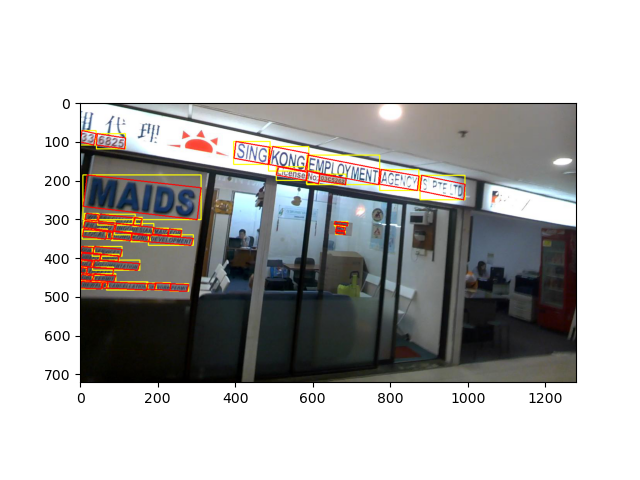

['###', '###', 'ELEVEn']
tensor([[0.3461, 0.1806, 0.2406, 0.0778],
        [0.5367, 0.1542, 0.1328, 0.0472],
        [0.9414, 0.1264, 0.0844, 0.0500]])


<IPython.core.display.Javascript object>


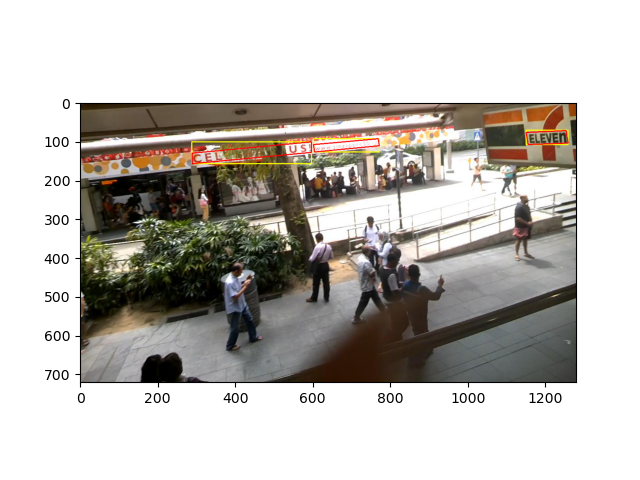

['###', 'prefer', 'VISA', 'OOTOYA', '###', '###', 'Japanese', 'Restaurant', '###', '###']
tensor([[0.3953, 0.7403, 0.0234, 0.0417],
        [0.4332, 0.7576, 0.0445, 0.0542],
        [0.4207, 0.8062, 0.0617, 0.0847],
        [0.6363, 0.5903, 0.0836, 0.0389],
        [0.6348, 0.4757, 0.1242, 0.1431],
        [0.6582, 0.5604, 0.0805, 0.0403],
        [0.6086, 0.6160, 0.0469, 0.0264],
        [0.6637, 0.6229, 0.0617, 0.0264],
        [0.1418, 0.1104, 0.0602, 0.1208],
        [0.1434, 0.1743, 0.0570, 0.0875]])


<IPython.core.display.Javascript object>


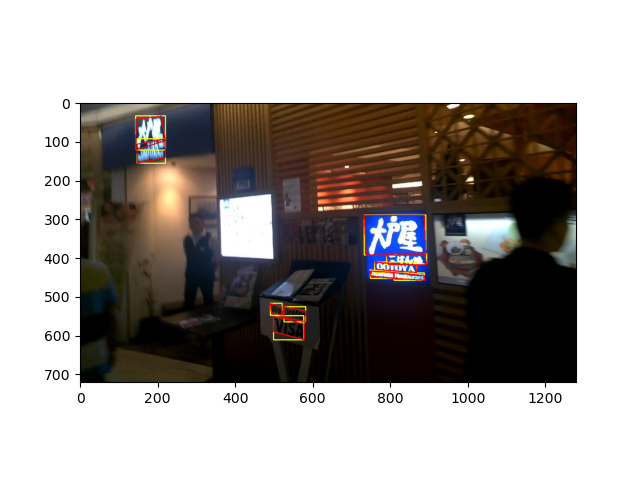

['EXIT', 'buzz', '###', '###', 'Lee', 'Man', 'pays', 'car', 'Umisushi', 'bento']
tensor([[0.3883, 0.1528, 0.0703, 0.0694],
        [0.6875, 0.3000, 0.0406, 0.0306],
        [0.7816, 0.3118, 0.0164, 0.0264],
        [0.8078, 0.2986, 0.0203, 0.0361],
        [0.8332, 0.2889, 0.0258, 0.0361],
        [0.8844, 0.2660, 0.0344, 0.0431],
        [0.9301, 0.2493, 0.0461, 0.0458],
        [0.9809, 0.2285, 0.0367, 0.0458],
        [0.5977, 0.4951, 0.0344, 0.2292],
        [0.6582, 0.4868, 0.0305, 0.0181]])


<IPython.core.display.Javascript object>


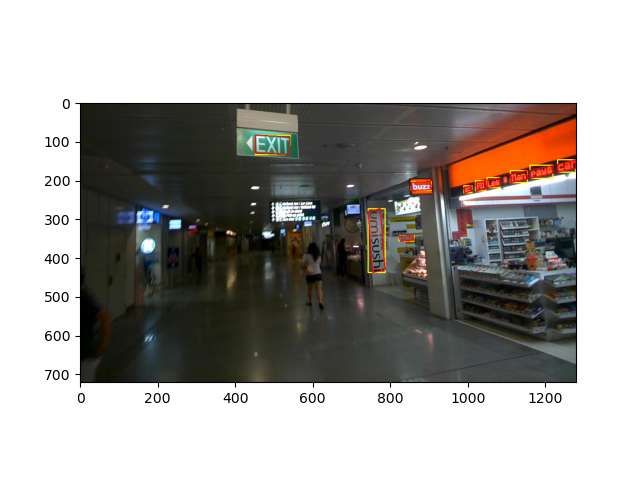

['FLIGHT', '###']
tensor([[0.5992, 0.0361, 0.0906, 0.0556],
        [0.8816, 0.3292, 0.0555, 0.0528]])


<IPython.core.display.Javascript object>


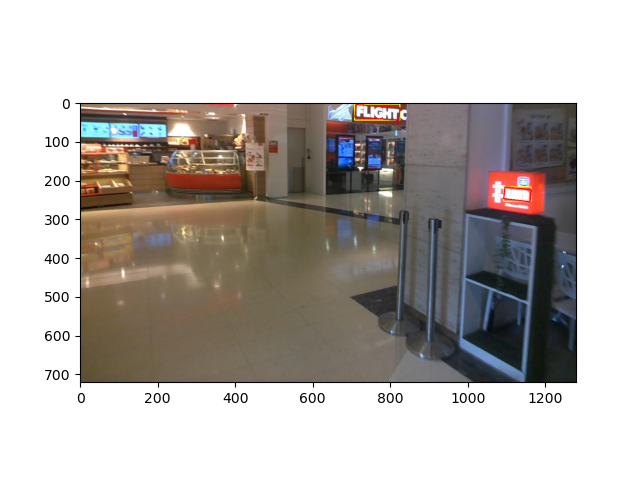

['1KG', 'Body', 'Xndo', 'FREE', 'FREE', 'SHEE', '###', 'KIMIO', 'Blanc', 'LOSE', 'Composition', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.4707, 0.3389, 0.0195, 0.0139],
        [0.5094, 0.2069, 0.0203, 0.0250],
        [0.5516, 0.0903, 0.0844, 0.1250],
        [0.5230, 0.1646, 0.0461, 0.0486],
        [0.6148, 0.1958, 0.0297, 0.0528],
        [0.8156, 0.2688, 0.0656, 0.0347],
        [0.3578, 0.3458, 0.0188, 0.0500],
        [0.9328, 0.7229, 0.1328, 0.0986],
        [0.3605, 0.2597, 0.0195, 0.1056],
        [0.4734, 0.3229, 0.0266, 0.0181],
        [0.5219, 0.2319, 0.0453, 0.0250],
        [0.5164, 0.2549, 0.0359, 0.0236],
        [0.6074, 0.2410, 0.0133, 0.0236],
        [0.5676, 0.3792, 0.0242, 0.0139],
        [0.2379, 0.1403, 0.0633, 0.0417],
        [0.1145, 0.1667, 0.0383, 0.0361],
        [0.8352, 0.1396, 0.0703, 0.0347],
        [0.9500, 0.2514, 0.0547, 0.0278],
        [0.9695, 0.8194, 0.0469, 0.0417],
        [0.6156, 0.2625, 0.0281, 0.0

<IPython.core.display.Javascript object>


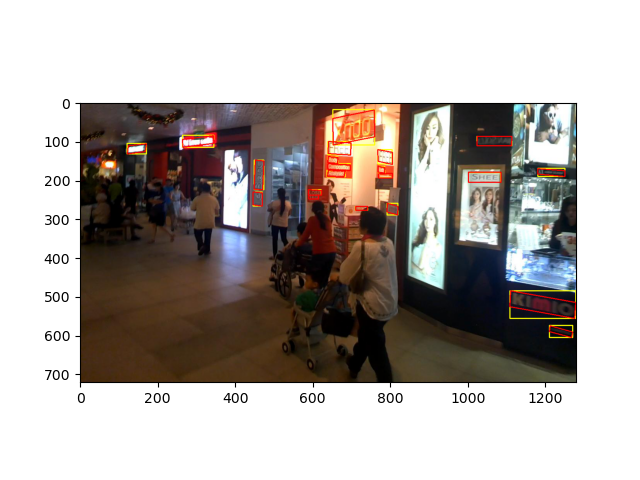

['HUBL', '###', 'MARDIN', '###']
tensor([[0.9141, 0.1535, 0.1656, 0.2236],
        [0.5566, 0.3569, 0.0227, 0.0417],
        [0.5840, 0.3299, 0.0305, 0.0542],
        [0.2457, 0.4479, 0.2211, 0.0542]])


<IPython.core.display.Javascript object>


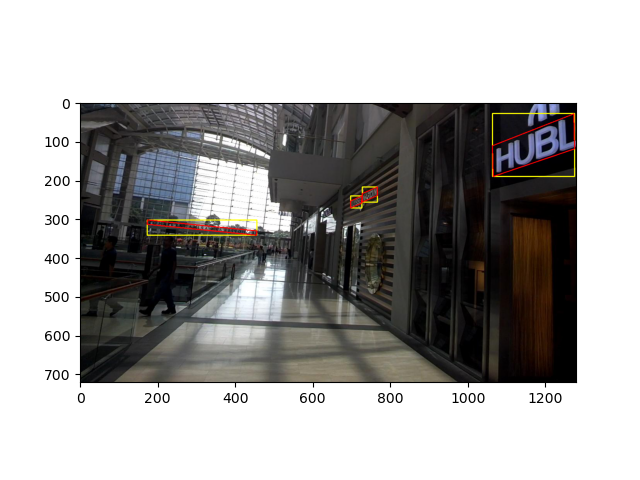

['###', '"We', 'insurance', '###', '###', '###', '154', 'redefining', '###', '###', '###', '###', 'more', 'than', 'manage', 'claims.', '###', 'also', 'help', 'rebuild', 'lives."']
tensor([[0.8742, 0.3167, 0.0391, 0.0250],
        [0.8215, 0.1778, 0.0305, 0.0389],
        [0.6582, 0.1174, 0.0586, 0.0569],
        [0.5836, 0.2625, 0.0156, 0.0250],
        [0.5945, 0.2785, 0.0391, 0.0431],
        [0.6234, 0.1417, 0.0125, 0.0278],
        [0.6773, 0.2264, 0.0359, 0.0722],
        [0.5949, 0.1625, 0.0461, 0.0528],
        [0.6457, 0.6792, 0.0383, 0.0278],
        [0.8480, 0.3132, 0.0180, 0.0403],
        [0.8586, 0.3028, 0.0109, 0.0194],
        [0.8477, 0.1778, 0.0187, 0.0361],
        [0.8742, 0.1847, 0.0328, 0.0250],
        [0.9023, 0.1806, 0.0281, 0.0333],
        [0.9359, 0.1875, 0.0391, 0.0306],
        [0.9684, 0.1840, 0.0352, 0.0319],
        [0.8301, 0.2271, 0.0258, 0.0347],
        [0.8570, 0.2271, 0.0281, 0.0347],
        [0.8848, 0.2285, 0.0273, 0.0375],
        [0.9164, 0.225

<IPython.core.display.Javascript object>


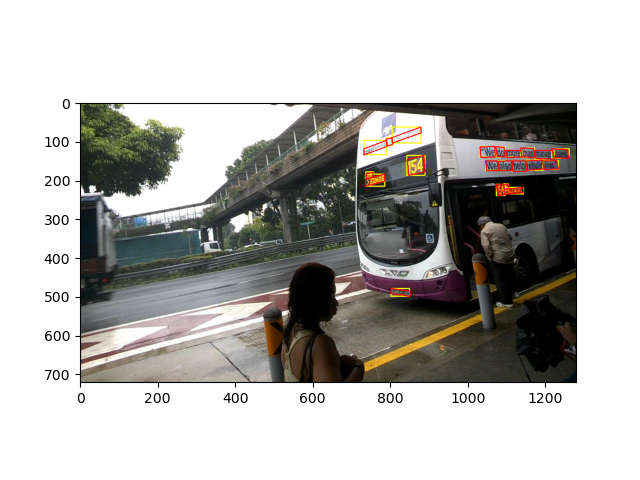

['###', 'The', '###', 'Carpark', '###', 'Ramp', 'Exchange', 'The', '###', '###', '###', 'Indulge', '###', 'The', 'Runway', '###', 'Indulge', '###', 'The', 'Runway', '###', 'Indulge', '###', 'Discovery', 'Walk', '###', 'B-One', '###', 'The', 'Med', '###', 'Med', 'L12', 'L11', 'L10', '###', '###', '###', 'Access', '###', 'all', 'floors.', 'please', 'transfer', '###', 'Level', '###', 'Roof', 'Garden', 'Roof', 'Garden', 'Carpark', 'Verandah', '###', 'Carpark', 'Verandah', '###', 'Carpark', 'The', 'Ramp', '###', 'Carpark']
tensor([[0.3867, 0.2847, 0.0250, 0.0306],
        [0.3078, 0.2896, 0.0375, 0.0347],
        [0.2867, 0.0590, 0.0141, 0.0375],
        [0.3250, 0.0625, 0.0625, 0.0333],
        [0.3785, 0.0632, 0.0211, 0.0292],
        [0.2555, 0.0604, 0.0484, 0.0403],
        [0.2141, 0.1007, 0.0812, 0.0403],
        [0.2129, 0.0590, 0.0305, 0.0403],
        [0.2629, 0.1000, 0.0195, 0.0361],
        [0.2770, 0.0993, 0.0164, 0.0347],
        [0.2906, 0.0979, 0.0141, 0.0347],
        [0.327

<IPython.core.display.Javascript object>


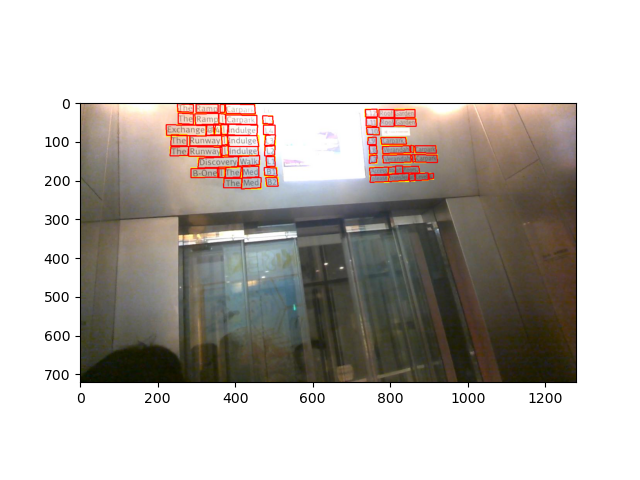

['FLIGHT', '###']
tensor([[0.5992, 0.0361, 0.0906, 0.0556],
        [0.8816, 0.3292, 0.0555, 0.0528]])


<IPython.core.display.Javascript object>


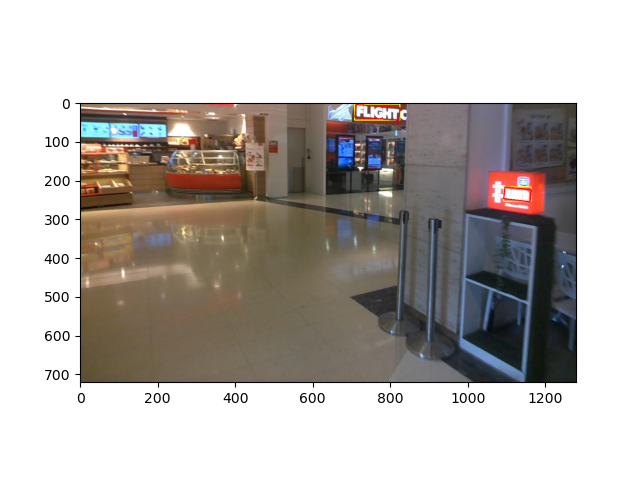

['REVLO', 'DHC', 'DHC', 'yog']
tensor([[0.9375, 0.0590, 0.0953, 0.0569],
        [0.6660, 0.1403, 0.0430, 0.0444],
        [0.6719, 0.2715, 0.0375, 0.0319],
        [0.5398, 0.1708, 0.0594, 0.0694]])


<IPython.core.display.Javascript object>

['connexis', '###', '###', '###']
tensor([[0.4660, 0.2681, 0.0508, 0.0306],
        [0.4551, 0.2917, 0.0211, 0.0222],
        [0.4770, 0.2875, 0.0242, 0.0222],
        [0.4547, 0.3313, 0.0156, 0.0125]])


<IPython.core.display.Javascript object>

In [8]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Focused Scene Text

In [9]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARFocusedSceneTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['Station', 'car', 'park']
tensor([[0.4164, 0.4021, 0.5391, 0.1542],
        [0.2219, 0.6354, 0.2344, 0.1167],
        [0.5586, 0.6313, 0.3328, 0.1875]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>

['66/1E', 'ESSER']
tensor([[0.4747, 0.2838, 0.0990, 0.0467],
        [0.5757, 0.6524, 0.0738, 0.0247]])


<IPython.core.display.Javascript object>


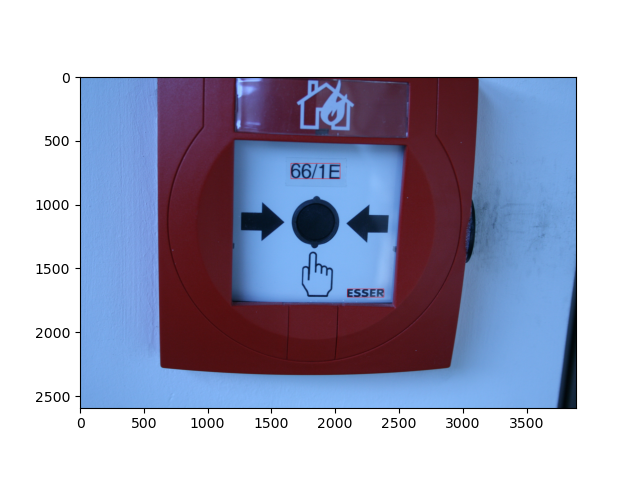

['4.513B', '###', 'Computing', 'Service', 'HELP', 'DESK']
tensor([[0.2115, 0.0539, 0.2917, 0.0609],
        [0.7885, 0.0387, 0.0542, 0.0258],
        [0.5052, 0.1813, 0.4729, 0.0609],
        [0.5031, 0.2523, 0.3312, 0.0484],
        [0.5016, 0.4773, 0.9135, 0.2688],
        [0.4927, 0.7969, 0.9583, 0.2578]])


<IPython.core.display.Javascript object>


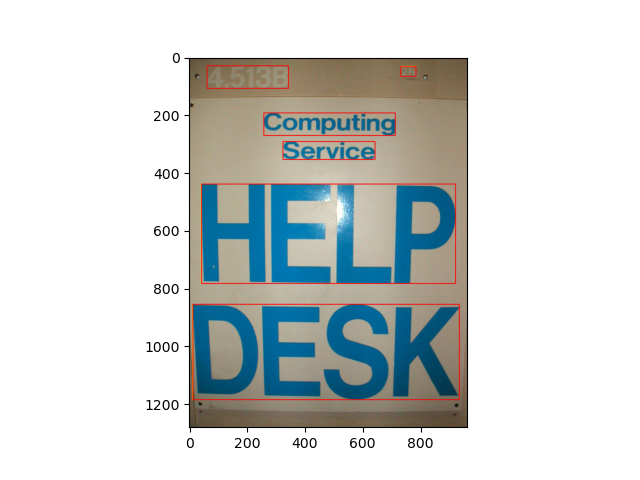

['Electrolux']
tensor([[0.5289, 0.4583, 0.3391, 0.0708]])


<IPython.core.display.Javascript object>


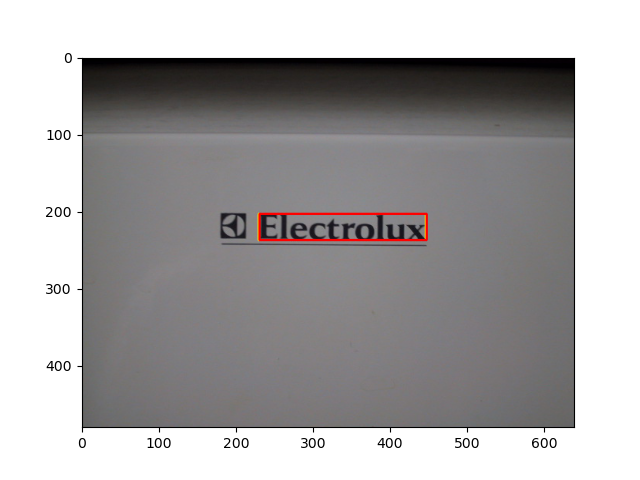

['Town', 'Centre', 'Clacton', '133', 'London', 'Chelmsford', 'Ipswich', 'Gt.', 'Yarmouth', 'Harwich', '###', 'Leisure', 'World', 'Rollerworld', '(A120)', '(A12)', '(A12)']
tensor([[0.4344, 0.1646, 0.1250, 0.0417],
        [0.6055, 0.1625, 0.1672, 0.0458],
        [0.1766, 0.3302, 0.2000, 0.0479],
        [0.3977, 0.3260, 0.0859, 0.0479],
        [0.7289, 0.4792, 0.1891, 0.0500],
        [0.7922, 0.5510, 0.3125, 0.0521],
        [0.1625, 0.4844, 0.1969, 0.0604],
        [0.0945, 0.5510, 0.0703, 0.0479],
        [0.2859, 0.5521, 0.2531, 0.0500],
        [0.1562, 0.7271, 0.2281, 0.0542],
        [0.3141, 0.3281, 0.0344, 0.0479],
        [0.1711, 0.2281, 0.0828, 0.0229],
        [0.2656, 0.2271, 0.0719, 0.0250],
        [0.1992, 0.2656, 0.1422, 0.0271],
        [0.1484, 0.8302, 0.2063, 0.0729],
        [0.1320, 0.6417, 0.1578, 0.0708],
        [0.7188, 0.6417, 0.1625, 0.0708]])


<IPython.core.display.Javascript object>


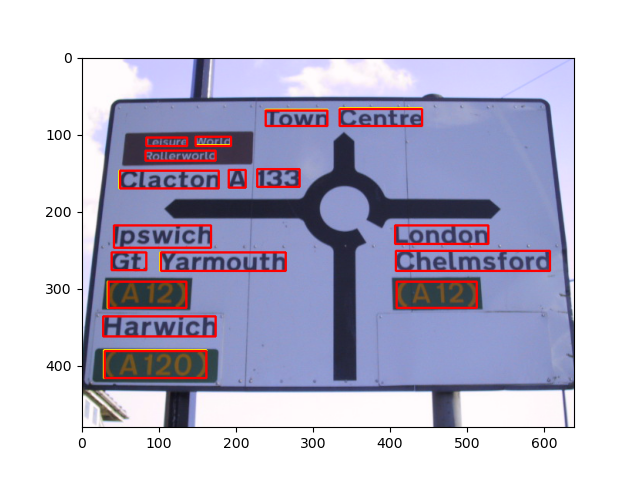

['WARNING!', 'LOW', 'FLYING', 'AND', 'AIRCRAFT', 'BLAST', 'CAUSE', 'PHYSICAL', 'INJURY', 'CAN', 'DEPARTING', '###', '###', '###', '###']
tensor([[0.5463, 0.6019, 0.1779, 0.0577],
        [0.2795, 0.6779, 0.0568, 0.0442],
        [0.3587, 0.6827, 0.0807, 0.0462],
        [0.4365, 0.6865, 0.0538, 0.0423],
        [0.6622, 0.6942, 0.1076, 0.0423],
        [0.3072, 0.7452, 0.0762, 0.0442],
        [0.4574, 0.7500, 0.0747, 0.0423],
        [0.5650, 0.7538, 0.1106, 0.0423],
        [0.6667, 0.7606, 0.0717, 0.0481],
        [0.3827, 0.7481, 0.0538, 0.0423],
        [0.5366, 0.6904, 0.1256, 0.0462],
        [0.3505, 0.2712, 0.0613, 0.0115],
        [0.5792, 0.2567, 0.0314, 0.0096],
        [0.6599, 0.2394, 0.0374, 0.0481],
        [0.4776, 0.1048, 0.0254, 0.0404]])


<IPython.core.display.Javascript object>


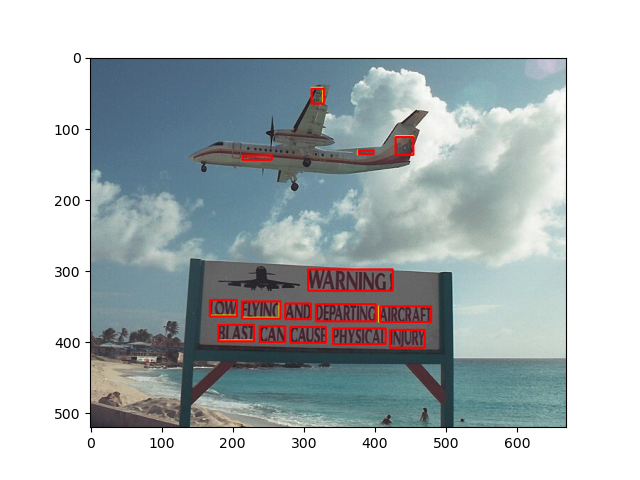

['PUSH']
tensor([[0.5266, 0.5177, 0.3625, 0.2271]])


<IPython.core.display.Javascript object>


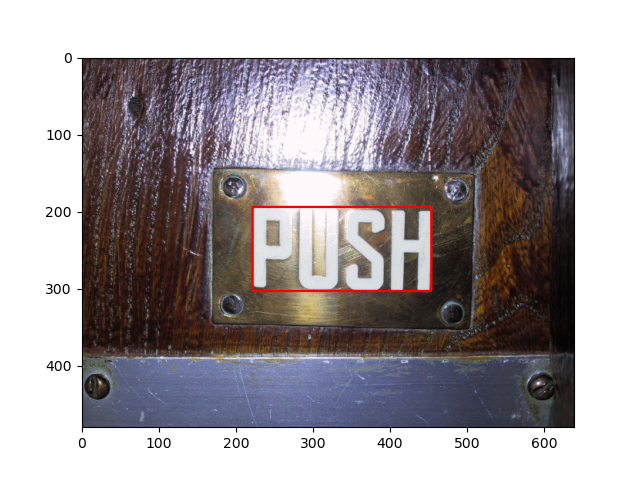

['Stationery', 'Box', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.3773, 0.5479, 0.5828, 0.1542],
        [0.8109, 0.5323, 0.2219, 0.1187],
        [0.1430, 0.9198, 0.0109, 0.0104],
        [0.2164, 0.9073, 0.0141, 0.0146],
        [0.4992, 0.9604, 0.0297, 0.0083],
        [0.6281, 0.9646, 0.0375, 0.0125],
        [0.0930, 0.9531, 0.0297, 0.0104],
        [0.0883, 0.9219, 0.0734, 0.0104],
        [0.0703, 0.9052, 0.0375, 0.0188],
        [0.1469, 0.9104, 0.0312, 0.0042],
        [0.1328, 0.9156, 0.0062, 0.0021],
        [0.2031, 0.9010, 0.0062, 0.0021],
        [0.2492, 0.9125, 0.0109, 0.0167],
        [0.2289, 0.9625, 0.0297, 0.0042],
        [0.2227, 0.9500, 0.0203, 0.0042],
        [0.2508, 0.9542, 0.0047, 0.0042],
        [0.5063, 0.9760, 0.0687, 0.0104],
        [0.6273, 0.9802, 0.0734, 0.0104],
        [0.9211, 0.9177, 0.0359, 0.0271]

<IPython.core.display.Javascript object>


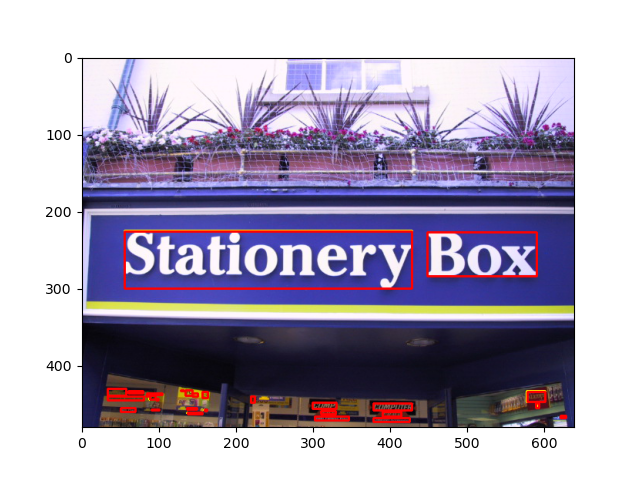

['Oleg', 'Rostanin', 'Asif', 'Shahab', '2.10']
tensor([[0.4313, 0.3542, 0.1193, 0.0910],
        [0.6155, 0.3522, 0.2109, 0.0710],
        [0.4807, 0.5127, 0.0998, 0.0718],
        [0.6352, 0.5127, 0.1803, 0.0702],
        [0.0248, 0.7417, 0.0435, 0.0258]])


<IPython.core.display.Javascript object>


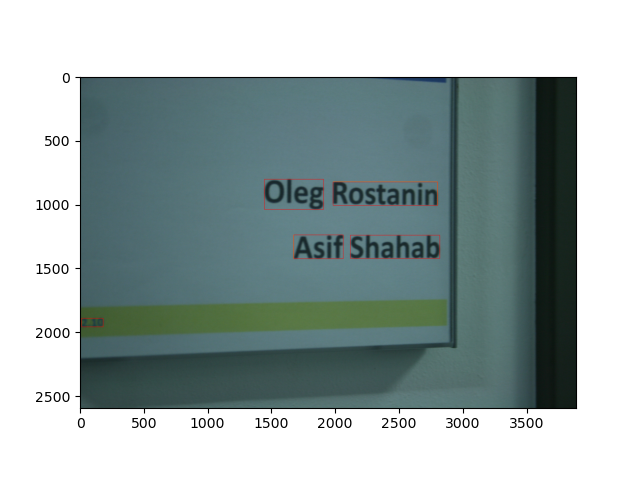

['FREE', 'DELIVERY']
tensor([[0.1969, 0.5417, 0.3156, 0.1542],
        [0.6852, 0.5573, 0.5359, 0.1521]])


<IPython.core.display.Javascript object>


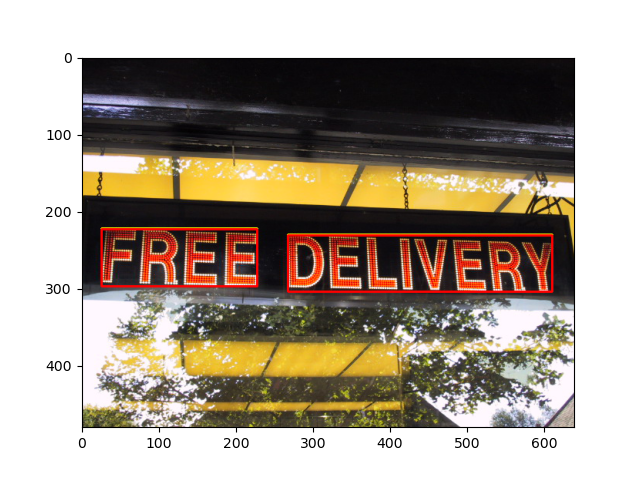

['Colchester']
tensor([[0.5039, 0.4062, 0.2539, 0.0547]])


<IPython.core.display.Javascript object>


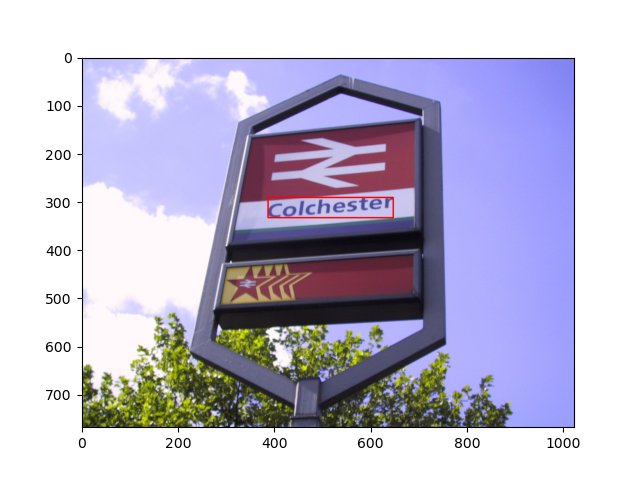

['NIGHT', 'EXIT', '###', 'FLOOR', '###']
tensor([[0.2836, 0.3422, 0.4641, 0.1510],
        [0.7801, 0.3380, 0.3461, 0.1531],
        [0.4918, 0.5443, 0.1930, 0.1406],
        [0.4203, 0.7307, 0.4750, 0.1365],
        [0.7809, 0.7271, 0.0852, 0.1333]])


<IPython.core.display.Javascript object>


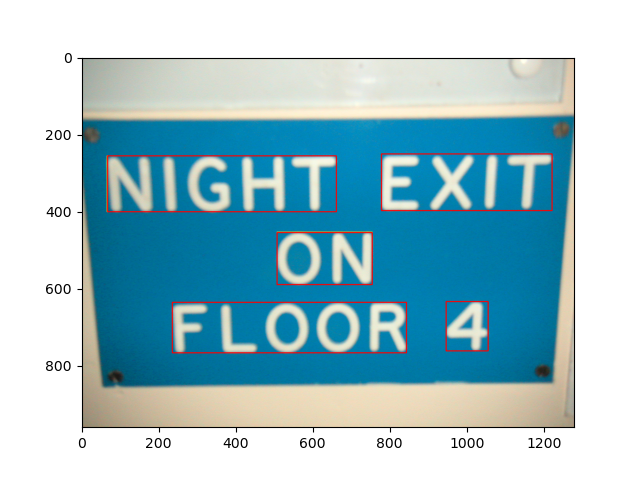

['STIRLING', 'CASTLE', "ARGYLL'S", 'LODGINGS']
tensor([[0.3469, 0.2646, 0.3438, 0.0667],
        [0.6828, 0.2552, 0.2719, 0.0646],
        [0.2859, 0.6208, 0.3594, 0.0708],
        [0.6961, 0.6115, 0.3984, 0.0771]])


<IPython.core.display.Javascript object>


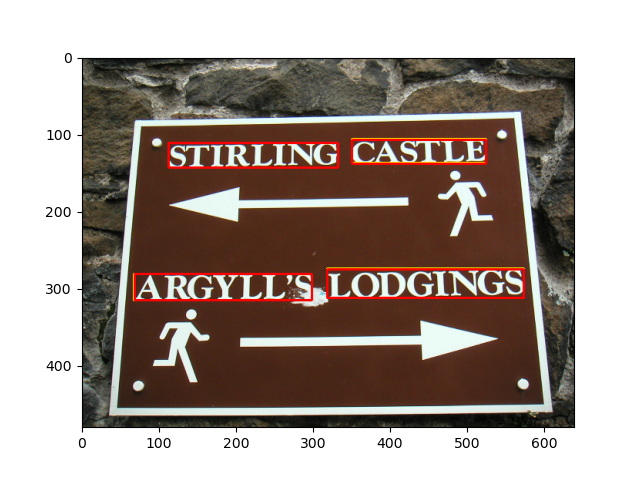

['FREE', 'DELIVERY']
tensor([[0.1969, 0.5417, 0.3156, 0.1542],
        [0.6852, 0.5573, 0.5359, 0.1521]])


<IPython.core.display.Javascript object>


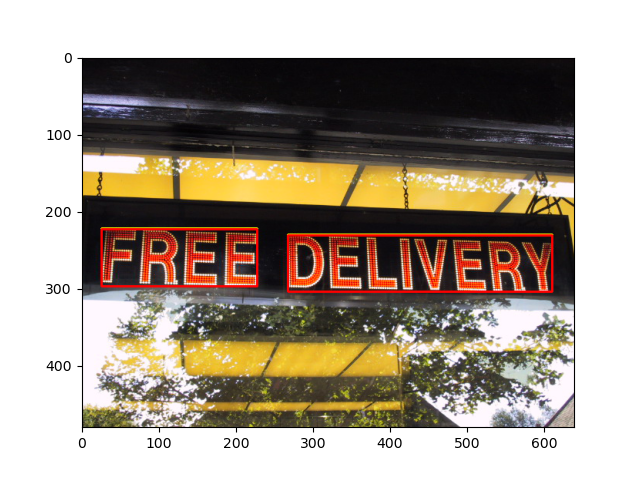

['###', '###', 'TIFICIAL', 'NTELLIGENCE', '###', 'MODERN', 'APPROACH', 'STUART', 'RUSSELL', 'PETER', 'NORVIG']
tensor([[0.3572, 0.3950, 0.0144, 0.0633],
        [0.4559, 0.3158, 0.0419, 0.0633],
        [0.6037, 0.3158, 0.2475, 0.0617],
        [0.5712, 0.3971, 0.4025, 0.0625],
        [0.4203, 0.4600, 0.0194, 0.0283],
        [0.4966, 0.4613, 0.1156, 0.0292],
        [0.6363, 0.4625, 0.1475, 0.0283],
        [0.1375, 0.5867, 0.1112, 0.0283],
        [0.1403, 0.6267, 0.1169, 0.0283],
        [0.1238, 0.6817, 0.0813, 0.0283],
        [0.1366, 0.7204, 0.1094, 0.0292]])


<IPython.core.display.Javascript object>


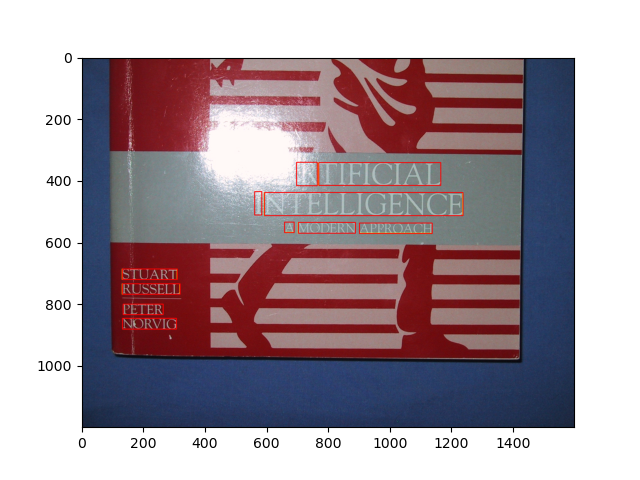

In [10]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Born Digital Images

In [11]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARBornDigitalTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['COLLECTIONS']
tensor([[0.2583, 0.8289, 0.5167, 0.0368]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


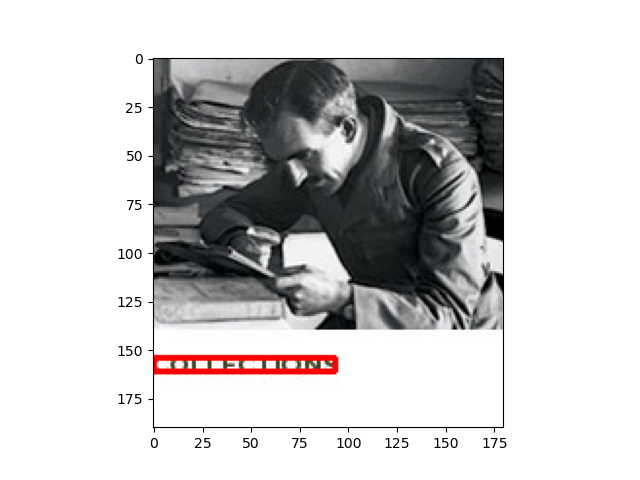

['LIBERTY', 'Ford', 'NORTHEAST', "OHIO'S", '###', 'FORD', 'DEALER', 'GROUP', 'Ford']
tensor([[0.4943, 0.1531, 0.8971, 0.2187],
        [0.5657, 0.2969, 0.2057, 0.1062],
        [0.3400, 0.4875, 0.3943, 0.0625],
        [0.6771, 0.4875, 0.2114, 0.0625],
        [0.8400, 0.4875, 0.0571, 0.0625],
        [0.2343, 0.5844, 0.1714, 0.0563],
        [0.4829, 0.5844, 0.2571, 0.0563],
        [0.7543, 0.5844, 0.2286, 0.0563],
        [0.5600, 0.2937, 0.1829, 0.0750]])


<IPython.core.display.Javascript object>


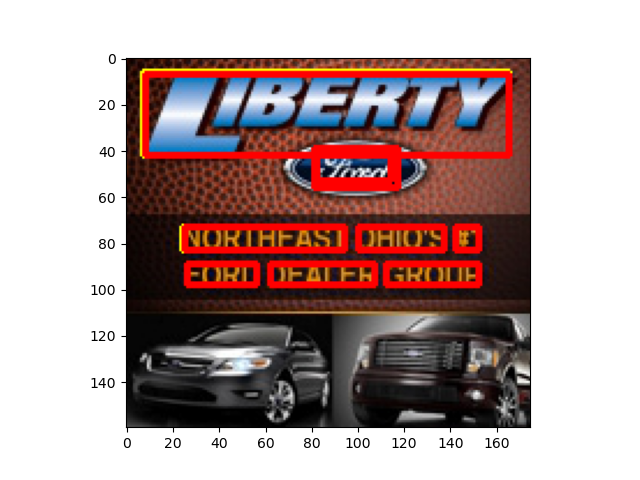

['Vodafone', '360', 'Bringing', 'your', 'world', 'together', 'Find', 'out', 'more', 'power', '###', 'you']
tensor([[0.5545, 0.4251, 0.0618, 0.0396],
        [0.6026, 0.4251, 0.0220, 0.0396],
        [0.5634, 0.5286, 0.0775, 0.0793],
        [0.6304, 0.5374, 0.0419, 0.0617],
        [0.6832, 0.5198, 0.0513, 0.0617],
        [0.7560, 0.5286, 0.0817, 0.0793],
        [0.5440, 0.6300, 0.0366, 0.0617],
        [0.5848, 0.6322, 0.0304, 0.0573],
        [0.6309, 0.6388, 0.0471, 0.0441],
        [0.5597, 0.7930, 0.0723, 0.0793],
        [0.6183, 0.7731, 0.0220, 0.0749],
        [0.6571, 0.7974, 0.0346, 0.0881]])


<IPython.core.display.Javascript object>


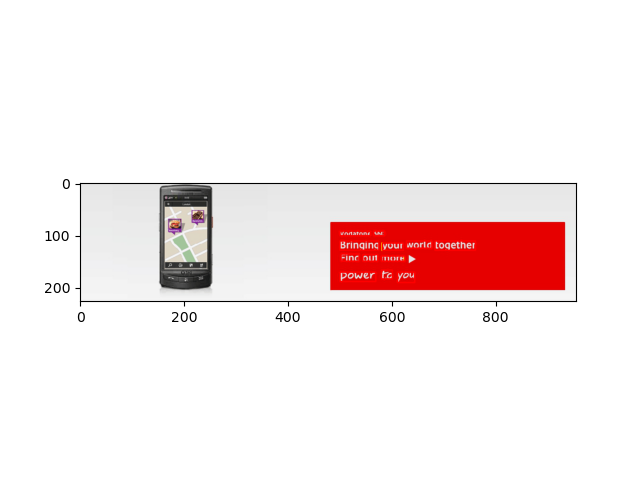

['enjoy', 'England', 'The', 'official', 'website', 'for', 'breaks', 'and', 'days', 'out', '###', 'England']
tensor([[0.0573, 0.3373, 0.0688, 0.2302],
        [0.1495, 0.3373, 0.1094, 0.2302],
        [0.2786, 0.3651, 0.0260, 0.0794],
        [0.3219, 0.3651, 0.0458, 0.0794],
        [0.3797, 0.3651, 0.0552, 0.0794],
        [0.4240, 0.3651, 0.0188, 0.0794],
        [0.4641, 0.3651, 0.0469, 0.0794],
        [0.5073, 0.3651, 0.0250, 0.0794],
        [0.5443, 0.3770, 0.0323, 0.1032],
        [0.5781, 0.3690, 0.0229, 0.0714],
        [0.6021, 0.3690, 0.0104, 0.0714],
        [0.6438, 0.3770, 0.0562, 0.1032]])


<IPython.core.display.Javascript object>


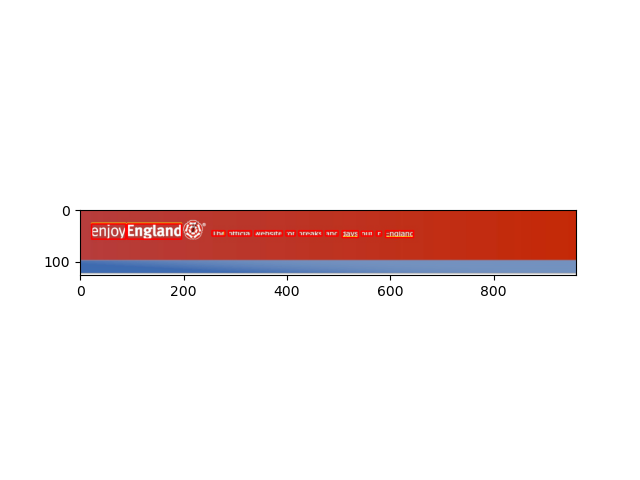

['stayLiverpool.com', '###', 'Bed', 'Apts', '###', 'Bed', 'Apts', 'from', '£55', 'from', '£65', 'per', 'night', '(sleeps', '###', 'per', 'night', '(sleeps', '###', 'RECEPTION', '24/7', 'SKY', 'SPORTS', 'WiFi', 'Book', 'now', '###']
tensor([[0.2918, 0.0911, 0.4418, 0.0636],
        [0.1982, 0.7034, 0.0073, 0.0254],
        [0.2464, 0.7044, 0.0564, 0.0275],
        [0.3209, 0.7087, 0.0673, 0.0360],
        [0.6564, 0.7044, 0.0145, 0.0275],
        [0.7082, 0.7044, 0.0564, 0.0275],
        [0.7818, 0.7087, 0.0655, 0.0360],
        [0.2173, 0.7797, 0.0709, 0.0297],
        [0.3118, 0.7733, 0.0891, 0.0466],
        [0.6764, 0.7797, 0.0691, 0.0297],
        [0.7691, 0.7744, 0.0873, 0.0445],
        [0.1755, 0.8316, 0.0418, 0.0233],
        [0.2400, 0.8284, 0.0655, 0.0339],
        [0.3273, 0.8273, 0.0873, 0.0318],
        [0.3927, 0.8284, 0.0218, 0.0297],
        [0.6336, 0.8316, 0.0418, 0.0233],
        [0.6982, 0.8284, 0.0655, 0.0339],
        [0.7855, 0.8284, 0.0873, 0.0339],
        [0.8

<IPython.core.display.Javascript object>


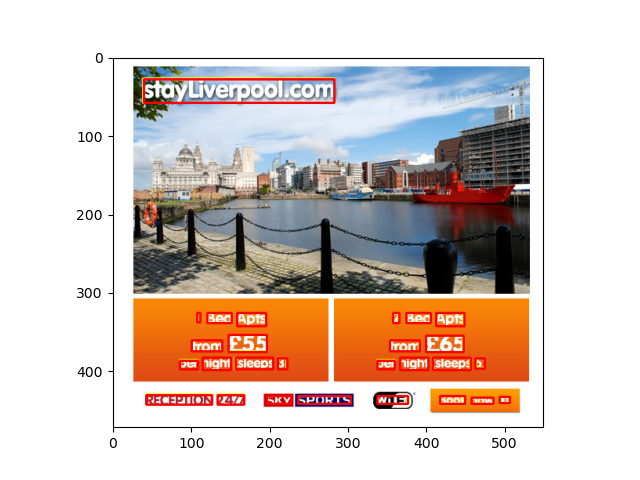

['SONY', 'Products', 'Shop', 'Support', 'Club', 'VAIO']
tensor([[0.1425, 0.1445, 0.1254, 0.1016],
        [0.3046, 0.2812, 0.0782, 0.0625],
        [0.4397, 0.2891, 0.0423, 0.0781],
        [0.5708, 0.2930, 0.0700, 0.0703],
        [0.8168, 0.6523, 0.0603, 0.1016],
        [0.8901, 0.6523, 0.0668, 0.1016]])


<IPython.core.display.Javascript object>


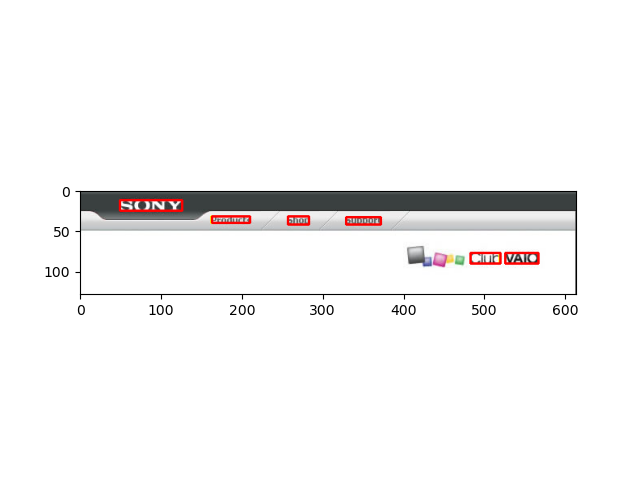

['Eye', 'Track', 'Asia', 'Visual', 'media', 'communication', '###', '###', 'Asian', 'context', 'Hong', '', 'January', '', '2011']
tensor([[0.0631, 0.4344, 0.0837, 0.2188],
        [0.1900, 0.4156, 0.1300, 0.1813],
        [0.3263, 0.4156, 0.1050, 0.1813],
        [0.0531, 0.6250, 0.0662, 0.0750],
        [0.1312, 0.6250, 0.0650, 0.0750],
        [0.2606, 0.6281, 0.1713, 0.0813],
        [0.0300, 0.7188, 0.0175, 0.0750],
        [0.0625, 0.7281, 0.0225, 0.0563],
        [0.1150, 0.7188, 0.0600, 0.0750],
        [0.1969, 0.7219, 0.0812, 0.0688],
        [0.0406, 0.9250, 0.0388, 0.0625],
        [0.0900, 0.9281, 0.0425, 0.0563],
        [0.1525, 0.9281, 0.0600, 0.0687],
        [0.2013, 0.9219, 0.0275, 0.0562],
        [0.2400, 0.9188, 0.0325, 0.0500]])


<IPython.core.display.Javascript object>


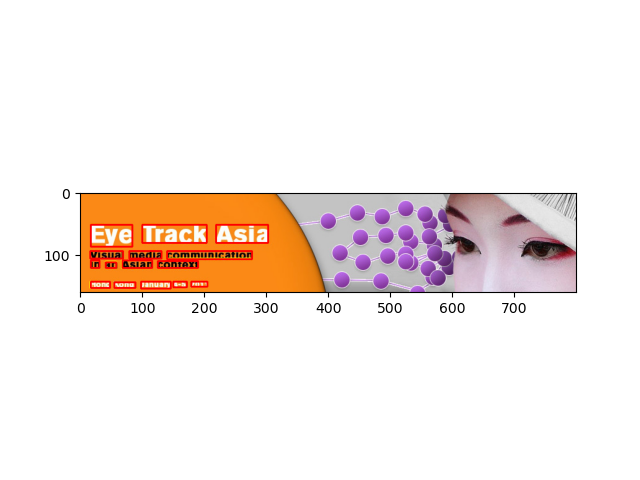

['WorldNomads.com', 'keep', 'travelling', 'safely', 'PACK', 'MORE', '###', 'YOUR', 'ADVENTURE', 'With', 'WorldNomads.Com']
tensor([[0.1525, 0.0809, 0.2150, 0.0539],
        [0.2942, 0.0931, 0.0517, 0.1176],
        [0.3600, 0.0980, 0.0900, 0.1078],
        [0.4267, 0.0980, 0.0600, 0.0980],
        [0.5108, 0.4020, 0.1950, 0.2647],
        [0.7308, 0.4020, 0.2083, 0.2647],
        [0.8942, 0.4044, 0.0683, 0.2598],
        [0.4942, 0.6225, 0.1583, 0.1569],
        [0.7583, 0.6225, 0.3433, 0.1569],
        [0.4608, 0.7623, 0.0950, 0.1127],
        [0.7250, 0.7623, 0.4067, 0.1127]])


<IPython.core.display.Javascript object>


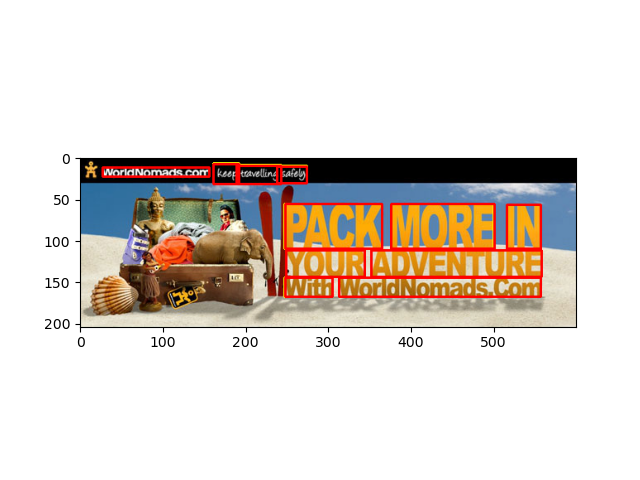

['Thomas', 'Cook', 'Sport', 'ARSENAL', 'MATCH', 'BREAKS', 'MATCH', 'TICKET', '###', 'FROM', 'ONLY', '£119*', 'CLICK', 'HERE', '*Terms', '###', 'conditions', 'apply']
tensor([[0.2417, 0.0225, 0.4333, 0.0183],
        [0.6250, 0.0225, 0.2667, 0.0183],
        [0.1417, 0.0450, 0.2333, 0.0167],
        [0.5000, 0.1650, 0.9333, 0.0333],
        [0.4958, 0.2100, 0.7083, 0.0333],
        [0.5042, 0.2533, 0.8083, 0.0333],
        [0.4250, 0.3650, 0.3833, 0.0167],
        [0.3500, 0.3917, 0.4000, 0.0167],
        [0.6583, 0.3917, 0.1167, 0.0167],
        [0.3125, 0.5992, 0.3750, 0.0217],
        [0.7417, 0.5992, 0.3500, 0.0217],
        [0.5167, 0.6467, 0.7500, 0.0433],
        [0.3625, 0.9400, 0.2250, 0.0133],
        [0.6125, 0.9400, 0.2083, 0.0100],
        [0.1583, 0.9883, 0.2500, 0.0133],
        [0.3333, 0.9883, 0.0667, 0.0133],
        [0.5583, 0.9867, 0.3500, 0.0133],
        [0.8500, 0.9892, 0.1833, 0.0183]])


<IPython.core.display.Javascript object>


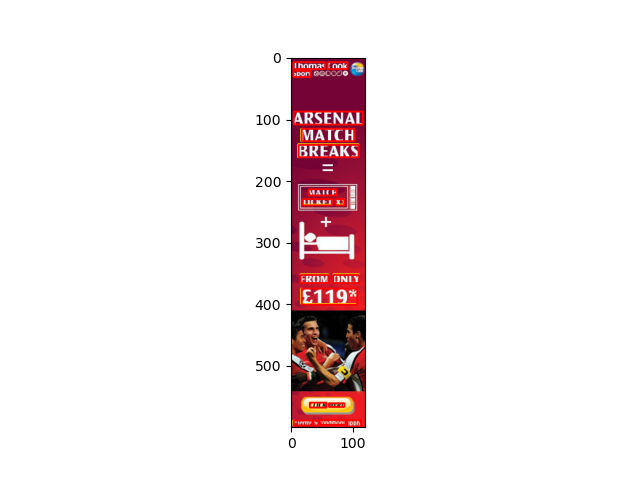

['Info', 'Management', 'Hub']
tensor([[0.1436, 0.7538, 0.1485, 0.0615],
        [0.5743, 0.7731, 0.6139, 0.0692],
        [0.4851, 0.8462, 0.1782, 0.0615]])


<IPython.core.display.Javascript object>


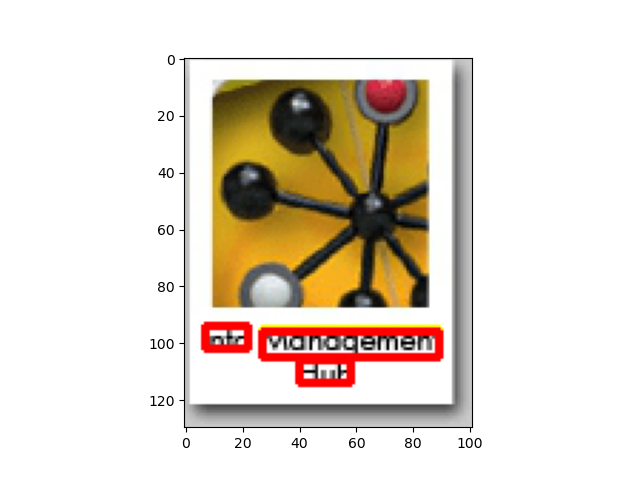

['Must', 'Go!', 'Falcon', 'Hopper', 'Unisex', 'Bike', '###', 'White', '12"', 'Was', '£57.97', 'NOW', '£28.99', '50%', 'Off']
tensor([[0.6795, 0.1233, 0.1227, 0.0933],
        [0.7977, 0.2067, 0.0955, 0.0667],
        [0.2045, 0.6883, 0.1727, 0.0300],
        [0.4159, 0.6933, 0.1864, 0.0400],
        [0.6364, 0.6883, 0.1727, 0.0300],
        [0.1727, 0.7450, 0.1091, 0.0300],
        [0.2636, 0.7500, 0.0091, 0.0000],
        [0.3773, 0.7450, 0.1636, 0.0300],
        [0.5273, 0.7450, 0.0727, 0.0300],
        [0.1659, 0.8383, 0.1045, 0.0300],
        [0.3409, 0.8383, 0.1818, 0.0300],
        [0.2023, 0.9033, 0.1682, 0.0400],
        [0.4364, 0.9033, 0.2273, 0.0400],
        [0.7182, 0.8517, 0.0727, 0.0233],
        [0.8091, 0.8517, 0.0636, 0.0233]])


<IPython.core.display.Javascript object>


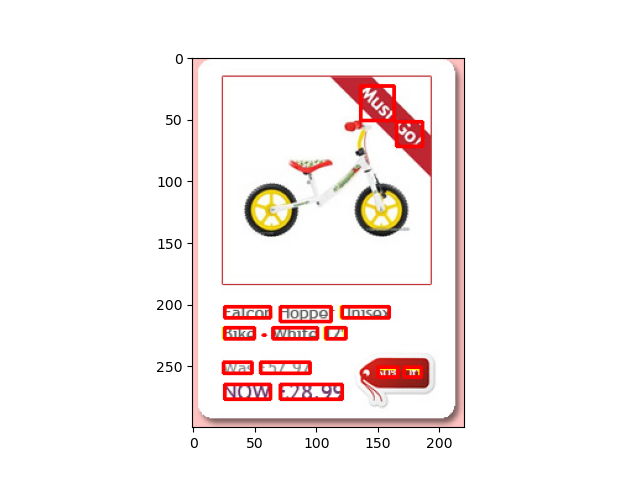

['New', 'releases', '###', 'DVD', '###', '###', '###', 'Star', 'Trek', '###', 'Angels', '###', 'Demons', '###', 'G.I.', 'Joe:', 'The', 'Rise', '###', 'Cobra', '###', 'The', 'Ugly', 'Truth', '###', 'Transformers:', 'Revenge', '###', 'the', 'Fallen', '###', 'Monsters', 'vs.', 'Aliens', '###', 'The', 'Proposal', '###', 'Ice', 'Age:', 'Dawn', '###', 'the', 'Dinosaurs', '10.', 'X-Men', 'Origins:', 'Wolverine', 'STAR', 'TREK', '###', 'the', 'ugly', 'truth']
tensor([[0.1208, 0.0870, 0.1409, 0.0481],
        [0.3523, 0.0852, 0.2752, 0.0519],
        [0.5503, 0.0926, 0.0738, 0.0370],
        [0.6829, 0.0870, 0.1376, 0.0481],
        [0.0789, 0.1889, 0.0235, 0.0296],
        [0.1409, 0.1926, 0.0470, 0.0370],
        [0.0772, 0.2556, 0.0268, 0.0296],
        [0.1544, 0.2556, 0.0671, 0.0296],
        [0.2399, 0.2556, 0.0772, 0.0296],
        [0.0772, 0.3222, 0.0268, 0.0296],
        [0.1745, 0.3259, 0.1208, 0.0370],
        [0.2617, 0.3222, 0.0201, 0.0296],
        [0.3624, 0.3222, 0.1409, 0.0296]

<IPython.core.display.Javascript object>


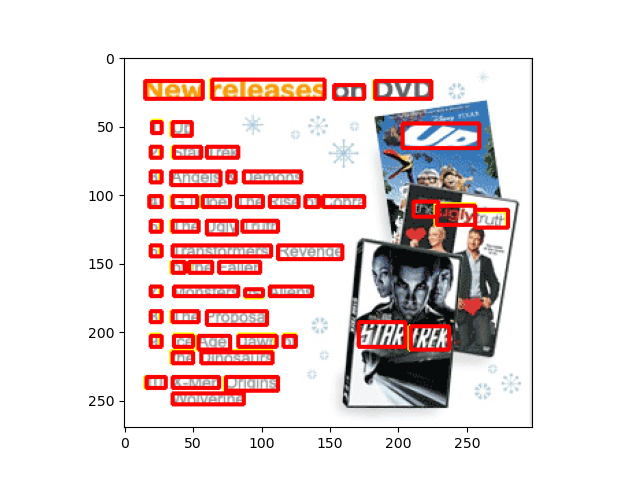

['BMW', 'model', 'range']
tensor([[0.1187, 0.0738, 0.2250, 0.0984],
        [0.3844, 0.0779, 0.2438, 0.0902],
        [0.6594, 0.1025, 0.2188, 0.0902]])


<IPython.core.display.Javascript object>


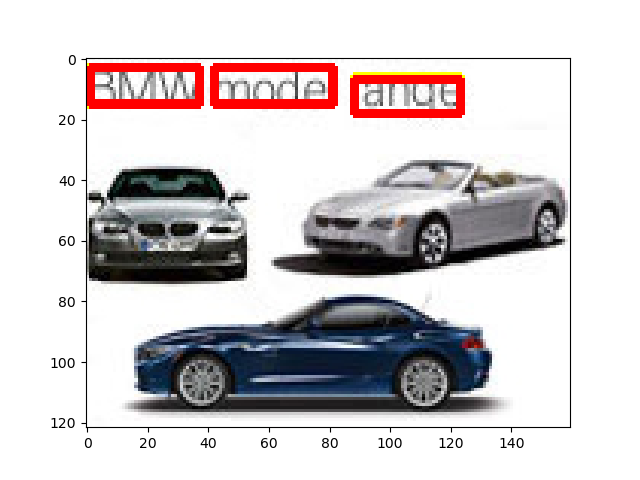

['SHOT', '###', 'THE', 'DAY', 'CLICK', '###', 'MORE']
tensor([[0.1439, 0.1698, 0.1515, 0.0802],
        [0.2784, 0.1636, 0.0720, 0.0679],
        [0.3864, 0.1605, 0.1136, 0.0741],
        [0.5189, 0.1512, 0.1288, 0.0802],
        [0.6326, 0.8025, 0.0985, 0.0617],
        [0.7083, 0.7870, 0.0227, 0.0432],
        [0.7841, 0.7716, 0.1061, 0.0494]])


<IPython.core.display.Javascript object>


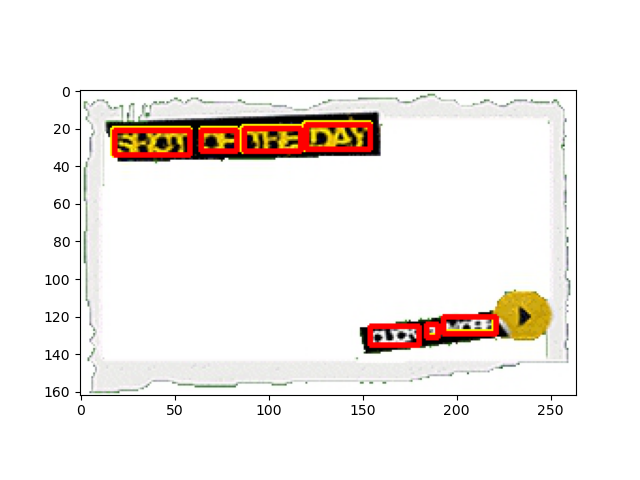

['The', 'Akamai', 'Quarterly', 'Akamai', '###', '###']
tensor([[0.1597, 0.6463, 0.0694, 0.1870],
        [0.2840, 0.6463, 0.1451, 0.1870],
        [0.4676, 0.6748, 0.1821, 0.2439],
        [0.9267, 0.6667, 0.1034, 0.0976],
        [0.0648, 0.5447, 0.0340, 0.1301],
        [0.0656, 0.7398, 0.0293, 0.1301]])


<IPython.core.display.Javascript object>


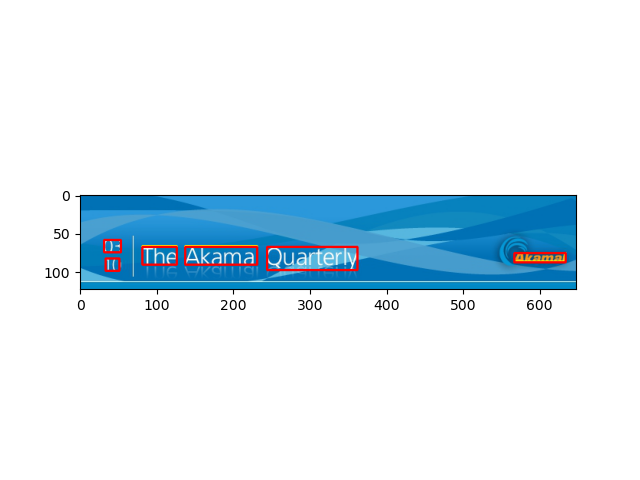

In [12]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)